<a href="https://colab.research.google.com/github/TaisiaKozharina/WSI_artifact_segmentation/blob/main/bach.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0. Imports

In [ ]:
! pip install imagecodecs
! pip install clustimage
! pip install -U clustimage
! pip install memory_profiler
! pip install tifffile

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.6/39.6 MB 39.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.3/51.3 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.9/42.9 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.4/42.4 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 12.2 MB/s eta 0:00:00


In [ ]:
!nvidia-smi

Mon May 20 12:21:10 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   52C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
# NN related
import torch
from torch import nn
import torchvision
from torchvision import transforms
from torchvision.transforms import v2
from torchvision.transforms.v2 import ToTensor
from torch.utils.data import DataLoader
from torchvision.transforms import ToPILImage

# Data preprocessing
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import torchvision.transforms.functional as F
from torch.nn.functional import max_pool2d
from glob import glob
from tifffile import imread, imwrite
from PIL import Image
from pathlib import Path
from skimage import measure
from skimage import color
import pandas as pd

# Other
import random
import os
import matplotlib.pyplot as plt
import numpy as np
import time
from tqdm.auto import tqdm
from tqdm import trange



In [ ]:
print("Torch version: ", torch.__version__)
print("TorchVision version: ", torchvision.__version__)

Torch version:  2.2.1+cu121
TorchVision version:  0.17.1+cu121


In [ ]:
! python3 --version

Python 3.10.12


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Device: {device}")

Device: cuda


# 1. READING DATA 💜

### 1.0. Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True) # force_remount=True

# PATHS
bin_map_dir = '/content/drive/MyDrive/pathdata/bin_maps/*.tif'
originals_dir = '/content/drive/MyDrive/pathdata/component_data/*.tif'


Mounted at /content/drive


In [ ]:
!ls "/content/drive/MyDrive/pathdata/"

bin_maps      clusters	      geoJSON_annotations  segments		  small_segments_18px.txt
bin_maps_old  component_data  seg_final_FAILED	   segments_with_padding  wsi_dataset


### 1.1 Data exploration: original channels

In [ ]:
original = torch.Tensor(imread(originals_dir.replace("*.tif", "BOMI2_TIL_1_Core[1,1,C]_[8663,35138]_component_data.tif"))).to("cpu")

print(original[0].shape)
print(torch.unique(original[0]))

print(original[6].shape)
print(torch.unique(original[6]))

print(original[7].shape)
print(torch.unique(original[7]))


torch.Size([2808, 3752])
tensor([0.0000e+00, 1.3161e-04, 1.5950e-04,  ..., 5.9534e+01, 5.9977e+01,
        6.0306e+01])
torch.Size([2808, 3752])
tensor([0.0000e+00, 8.2086e-07, 1.6211e-06,  ..., 6.3287e+01, 6.3304e+01,
        6.3327e+01])
torch.Size([2808, 3752])
tensor([0.0000e+00, 8.3787e-04, 5.0910e-03,  ..., 3.9386e+01, 3.9491e+01,
        4.1119e+01])


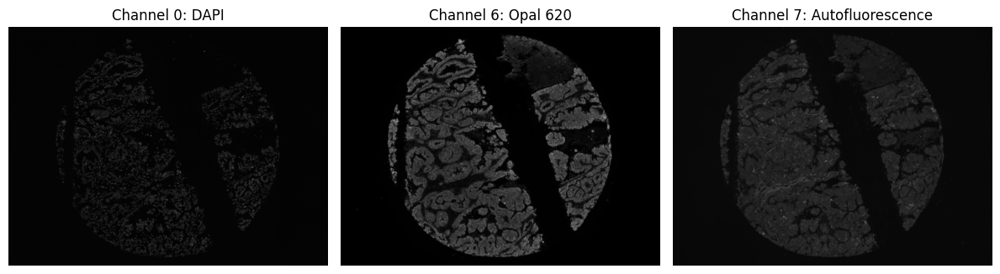

In [ ]:
fig,axes = plt.subplots(1, 3, figsize=(12, 18))

axes[0].imshow(original[0], cmap="gray")
axes[0].set_title(f"Channel 0: DAPI")
axes[0].axis('off')

axes[1].imshow(original[6], cmap="gray")
axes[1].set_title(f"Channel 6: Opal 620")
axes[1].axis('off')  # Turn off axis

axes[2].imshow(original[7], cmap="gray")
axes[2].set_title(f"Channel 7: Autofluorescence")
axes[2].axis('off')

plt.tight_layout()
plt.show()

torch.Size([3, 1])
tensor([[0.0000],
        [0.0000],
        [0.0667]])
torch.Size([3, 2808, 3752])


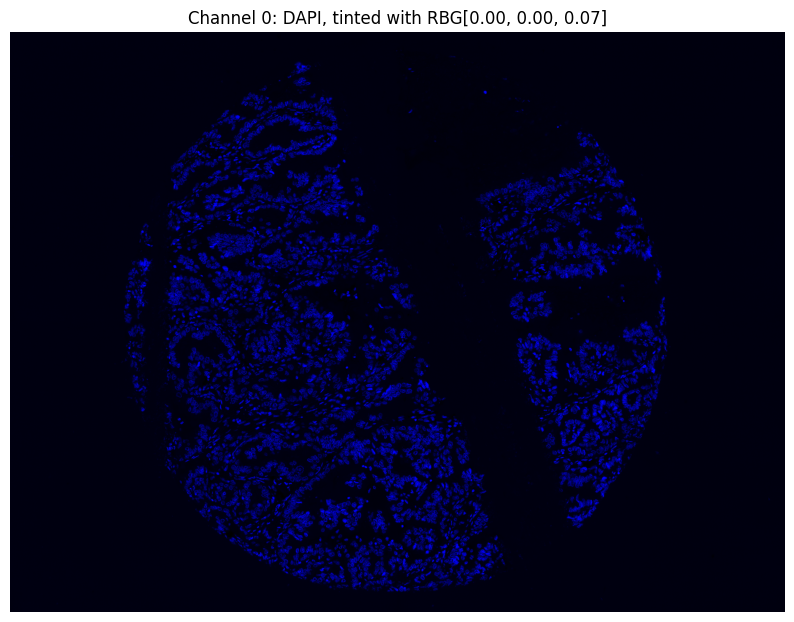

In [ ]:
tint_c0 = torch.Tensor([[0],[0], [100]])/1500
print(tint_c0.shape)
print(tint_c0)

color_channel_0 = original[0].repeat(3,1,1) * torch.unsqueeze(tint_c0,1)
print(color_channel_0.shape)

plt.figure(figsize=(10, 8))
plt.axis('off')
plt.title(f"Channel 0: DAPI, tinted with RBG[{tint_c0[0].item():.2f}, {tint_c0[1].item():.2f}, {tint_c0[2].item():.2f}]")
plt.imshow(color_channel_0.permute(1, 2, 0))

tensor([[0.0467],
        [0.0000],
        [0.0467]])


Error in callback <function _draw_all_if_interactive at 0x799140f11000> (for post_execute):


KeyboardInterrupt: 

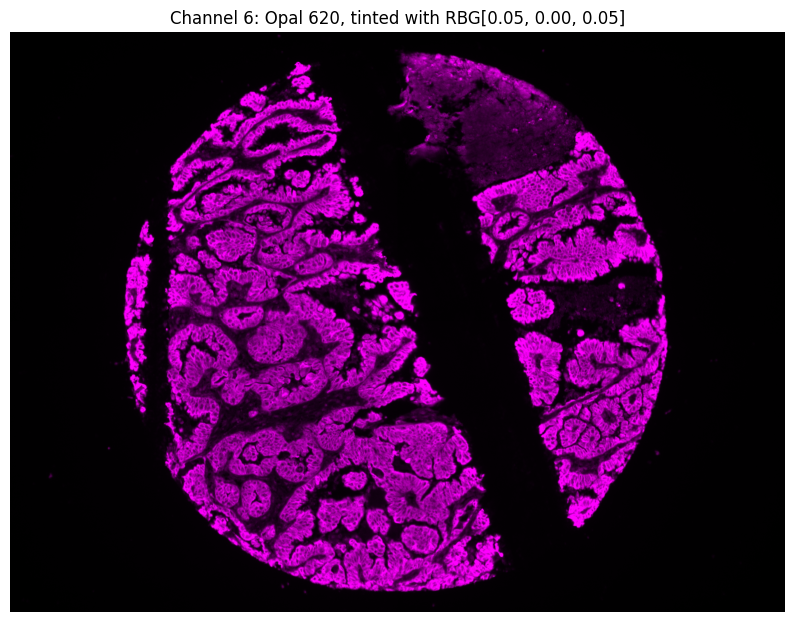

In [ ]:
tint_c6 = torch.Tensor([[70], [0], [70]])/1500
print(tint_c6)

color_channel_6 = original[6].repeat(3,1,1) * torch.unsqueeze(tint_c6,1)

plt.figure(figsize=(10, 8))
plt.axis('off')
plt.title(f"Channel 6: Opal 620, tinted with RBG[{tint_c6[0].item():.2f}, {tint_c6[1].item():.2f}, {tint_c6[2].item():.2f}]")
plt.imshow(color_channel_6.permute(1, 2, 0))


tensor([[0.0200],
        [0.0400],
        [0.0400]])


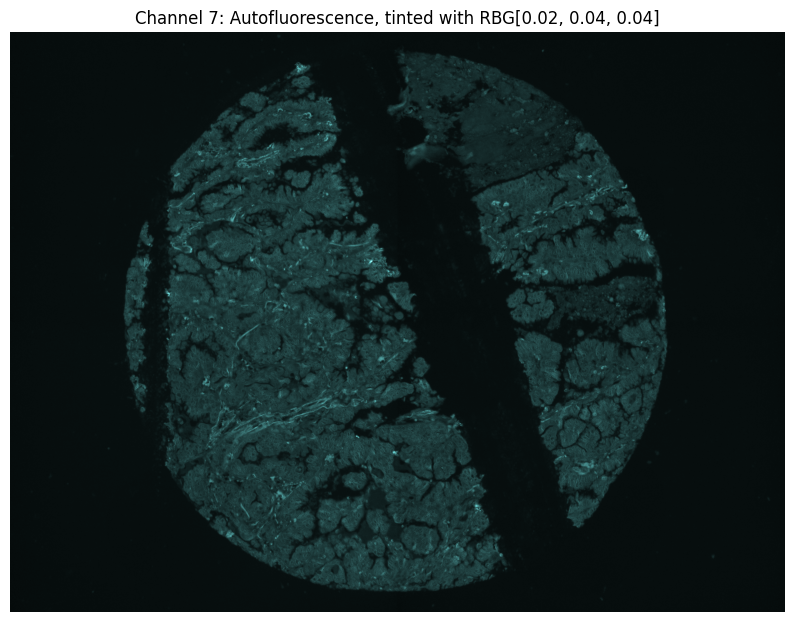

In [ ]:
tint_c7 = torch.Tensor([[30], [60], [60]])/1500
print(tint_c7)

color_channel_7 = original[7].repeat(3,1,1) * torch.unsqueeze(tint_c7,1)

plt.figure(figsize=(10, 8))
plt.axis('off')
plt.title(f"Channel 7: Autofluorescence, tinted with RBG[{tint_c7[0].item():.2f}, {tint_c7[1].item():.2f}, {tint_c7[2].item():.2f}]")
plt.imshow(color_channel_7.permute(1, 2, 0))

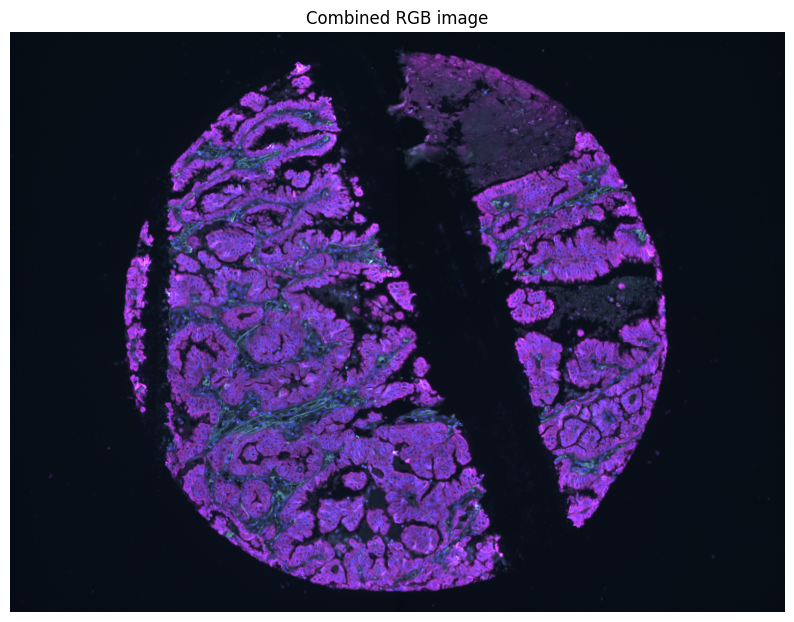

In [ ]:
alpha = 0.5
out = ((color_channel_0 * (1.0 - alpha) + color_channel_6 * alpha)*alpha + color_channel_7 * (1.0 - alpha))*2

plt.figure(figsize=(10, 8))
plt.axis('off')
plt.title(f"Combined RGB image")
plt.imshow(out.permute(1, 2, 0))

### 1.2. Define custom class for data samples

#### 1.2.1 Constants

In [ ]:
# Tints for image coloring
tint_c0 = (torch.Tensor([[0],[0], [100]])/1500)
tint_c6 = (torch.Tensor([[70], [0], [70]]) / 1500)
tint_c7 = (torch.Tensor([[30], [60], [60]]) / 1500)

# Image augmentation constants
DOWNSAMPLE_HEIGHT = 1000
ALPHA = 0.5
MARGIN = 10




#### 1.2.2 Helper functions

In [ ]:
def dilate_mask(mask: torch.Tensor, padding: int):
  '''
    Function to add padding to annotated segment mask using max pooling
  '''
  dilated_mask = max_pool2d(mask.unsqueeze(0), kernel_size=padding * 2 + 1, stride=1, padding=padding)
  dilated_mask = torch.where(dilated_mask > 0, 1, 0)

  return dilated_mask.squeeze(0)

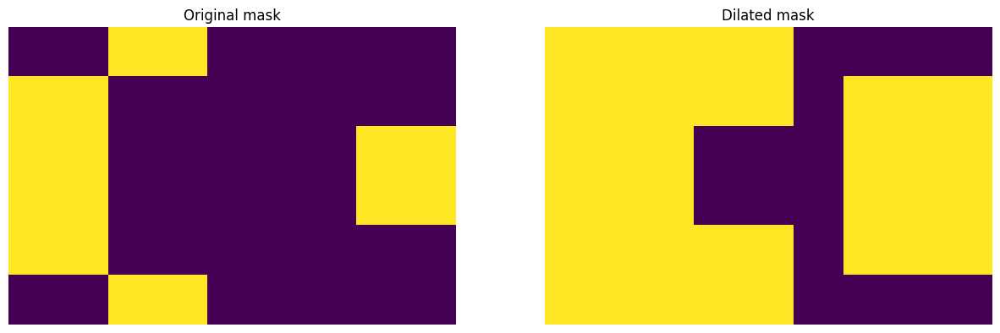

In [ ]:
# Demo for dilation
mask = torch.tensor([
    [0, 0, 1, 1, 0, 0, 0, 0, 0],
    [1, 1, 0, 0, 0, 0, 0, 0, 0],
    [1, 1, 0, 0, 0, 0, 0, 1, 1],
    [1, 1, 0, 0, 0, 0, 0, 1, 1],
    [1, 1, 0, 0, 0, 0, 0, 0, 0],
    [0, 0, 1, 1, 0, 0, 0, 0, 0]
], dtype=torch.float32)


padding = 1
padded_mask = dilate_mask(mask, padding)

fig, axes = plt.subplots(1, 2, figsize=(15, 8))

axes[0].imshow(mask)
axes[0].axis('off')
axes[0].set_title('Original mask')
axes[1].imshow(padded_mask)
axes[1].axis('off')
axes[1].set_title('Dilated mask')

plt.show()

In [ ]:
def color_WSI(path, resizing):
  '''
    Returns colored image as combination of 3 tinted channels, taking as input path of 8-channel original gray-scale image
  '''

  original = torch.Tensor(imread(path))

  if resizing:
    original = F.resize(original, [DOWNSAMPLE_HEIGHT])

  rbg_c0 = original[0].repeat(3,1,1)
  rbg_c6 = original[6].repeat(3,1,1)
  rbg_c7 = original[7].repeat(3,1,1)

  tinted_c0 = rbg_c0*torch.unsqueeze(tint_c0,1)
  tinted_c6 = rbg_c6*torch.unsqueeze(tint_c6,1)
  tinted_c7 = rbg_c7*torch.unsqueeze(tint_c7,1)

  out = torch.Tensor(((tinted_c0 * (1.0 - ALPHA) + tinted_c6 * ALPHA)*ALPHA + tinted_c7 * (1.0 - ALPHA))*2)

  return out

def extract_segmets(annotation, original, resizing):
  '''
    Returns individual (separated) segments cut outs taking as input original and annotation
  '''

  segments = []

  for channel in annotation:
    labeled = torch.Tensor(measure.label(channel, connectivity=2))
    labels = torch.unique(labeled)

    for label in labels[labels != 0]:
      mask = torch.where(labeled == label, 1, 0).repeat(3,1,1)
      if resizing:
        mask = F.resize(mask, [DOWNSAMPLE_HEIGHT])
      masked_original = original * mask
      segments.append(torch.Tensor(masked_original))


  return segments

#### 1.1.2 Dataset class

In [ ]:
class WSI_Dataset(Dataset):
    """
    Whole-Slide Image dataset

    Arguments:
          annotations_path (string): Path to the root folder on GDrive of annotations.
          images_path (string): Path to the root folder on GDrive of original WSI images.
          transform (callable, optional): Optional transform to be applied on a sample.
          demo_mode (Boolean): images are processed at lower quality for speed purposes and storage economy
          cached (Boolean): if enabled, data is cached for faster access (no recalculations if calculated previously, mosntly for segments)


      __getitem___(self, index):
        Returns sample elements by index. Index is taken in respect to unordered dataset stored on google drive.
        * id: string, ID of sample
        * original: torch.tensor, RBG combination of 3 channels,
        * annotation: torch.tensor, Grayscale annotation map,
        * segments: list of RBG separated annotated segments

    """

    def __init__(self, annotations_path, images_path, transform=None, demo_mode=False, cached=True, margin=0):

      self.annotations_path = annotations_path
      self.images_path = images_path
      self.transform = transform
      self.segment_margin = margin
      self.cache = {}  # Dictionary to cache samples
      self.cached = cached
      self.demo_mode = demo_mode

    def __len__(self):
      return len(glob(self.annotations_path))

    def __iter__(self):
        for i in range(len(self)):
            yield self[i]

    def __getitem__(self, index):

      if self.cached == True:
        if index in self.cache:  # Check if sample is already cached
          return self.cache[index]

      if torch.is_tensor(index):
          index = index.tolist()

      annotation_path = sorted(glob(self.annotations_path))[index]
      ID = Path(annotation_path).name.replace("_binary_map.tif","")
      original_path = self.images_path.replace("*.tif", f"{ID}_component_data.tif")

      #print(f"Provided Index: {index} \nID: {ID} \nMap path: {annotation_path}\nOriginals path: {original_path} \nImages path: {self.images_path} \nBin path: {self.annotations_path}")

      if original_path in glob(self.images_path):
        original = color_WSI(original_path, self.demo_mode)
        annotation = torch.Tensor(imread(annotation_path).astype(np.float32))
        segments = extract_segmets(annotation, original, self.demo_mode)

      else:
        print(f"Corresponding original image file not found for sample: {ID}")
        original = torch.Tensor([])
        annotation = torch.Tensor([])
        segments = []

      sample = {
          'id': ID,
          'original': original,
          'annotation': annotation,
          'segments': segments
      }

      if self.transform:
          sample = self.transform(sample)

      self.cache[index] = sample  # Cache the sample

      return sample


In [ ]:
def WSI(annotations_path, images_path, index=0):

  annotation_path = sorted(glob(annotations_path))[index]
  ID = Path(annotation_path).name.replace("_binary_map.tif","")
  original_path = images_path.replace("*.tif", f"{ID}_component_data.tif")

  if original_path in glob(images_path):
    original = torch.Tensor(imread(original_path))[[0, 6, 7], :, :]
    original_colored = color_WSI(original_path, False)
    annotation = torch.Tensor(imread(annotation_path).astype(np.float32))
    segments = extract_segmets(annotation, original, False)

  else:
    print(f"Corresponding original image file not found for sample: {ID}")
    original = torch.Tensor([])
    original_colored = torch.Tensor([])
    annotation = torch.Tensor([])
    segments = []

  sample = {
      'id': ID,
      'original': original,
      'original_colored' : original_colored,
      'annotation': annotation,
      'segments': segments
  }

  return sample

#### 1.2.3 Declaring WSI dataset

In [ ]:
wsi_samples = WSI_Dataset(bin_map_dir, originals_dir, cached=False, demo_mode=False)

print(f"\n🔊 TOTAL SAMPLE SIZE: {len(wsi_samples)}")
print(f"\n🔊 SAMPLE SHAPE: {wsi_samples[0]['original'].shape[0]} channel(s) or dimensions [{wsi_samples[0]['original'].shape[1]} x {wsi_samples[0]['original'].shape[2]}]")
print(f"\n🔊 Sample {wsi_samples[0]['id']} has {len(wsi_samples[0]['segments'])} segments")


🔊 TOTAL SAMPLE SIZE: 117

🔊 SAMPLE SHAPE: 3 channel(s) or dimensions [2808 x 3752]

🔊 Sample BOMI2_TIL_1_Core[1,1,A]_[5091,35249] has 27 segments


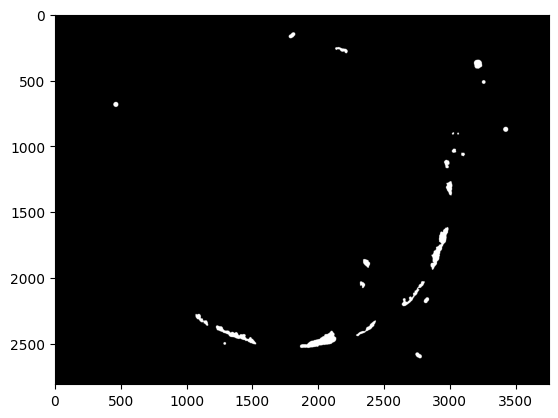

In [ ]:
plt.imshow(wsi_samples[0]['annotation'][0], cmap="gray")

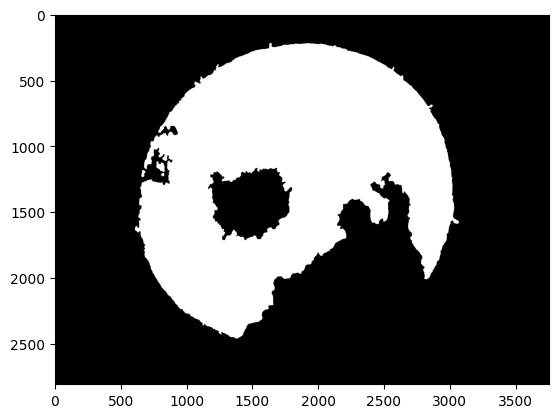

In [ ]:
plt.imshow(wsi_samples[0]['annotation'][1], cmap="gray")

In [ ]:
wsi_samples[0]['annotation'][1].shape

torch.Size([2808, 3752])

In [ ]:
def plot_sample(sample):

  annotation_c1 = F.resize(sample['annotation'][0].unsqueeze(0),[sample['original'].shape[1], sample['original'].shape[2]]).squeeze(0)
  annotation_c1_mask = np.ma.masked_where(annotation_c1 == 0, annotation_c1)

  annotation_c2 = F.resize(sample['annotation'][1].unsqueeze(0),[sample['original'].shape[1], sample['original'].shape[2]]).squeeze(0)
  annotation_c2_mask = np.ma.masked_where(annotation_c2 == 0, annotation_c2)

  plt.figure(figsize=(15, 15))

  plt.title(f"Sample: {sample['id']} - annotations")

  plt.imshow(sample['original'].permute(1, 2, 0))
  plt.imshow(annotation_c1_mask, cmap='Wistia', interpolation='none', alpha=ALPHA)
  plt.imshow(annotation_c2_mask, cmap='autumn', interpolation='none', alpha=ALPHA)

  plt.axis('off')
  plt.show()

Original shape: torch.Size([3, 2808, 3752])
Annotation (one channel) original shape: torch.Size([2808, 3752])


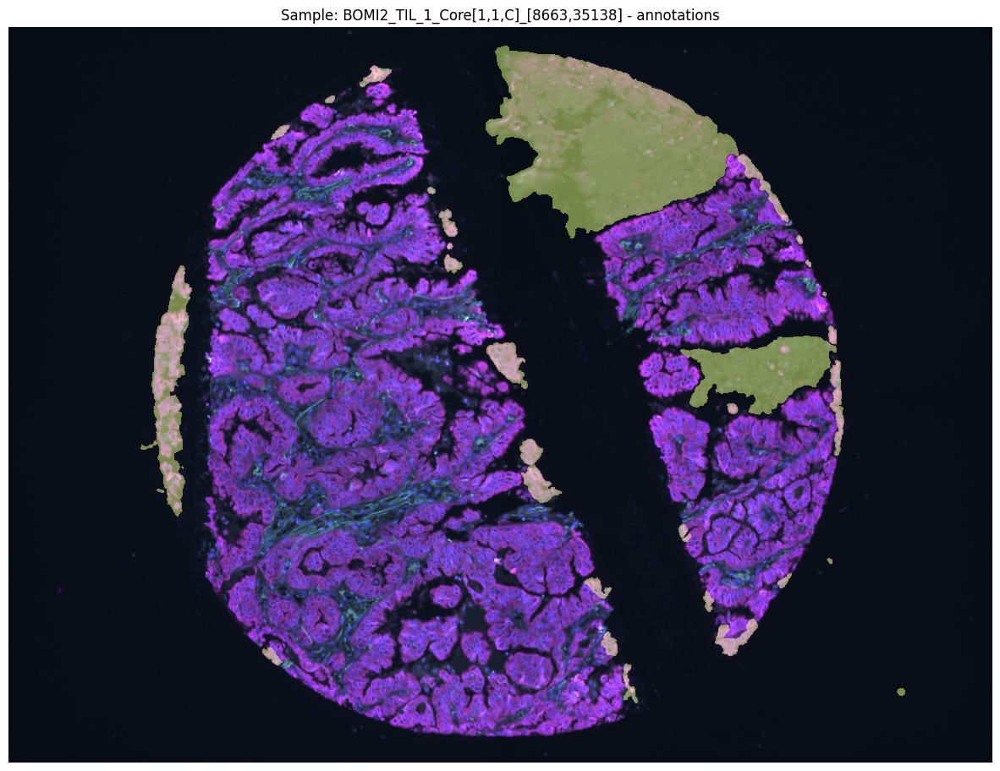

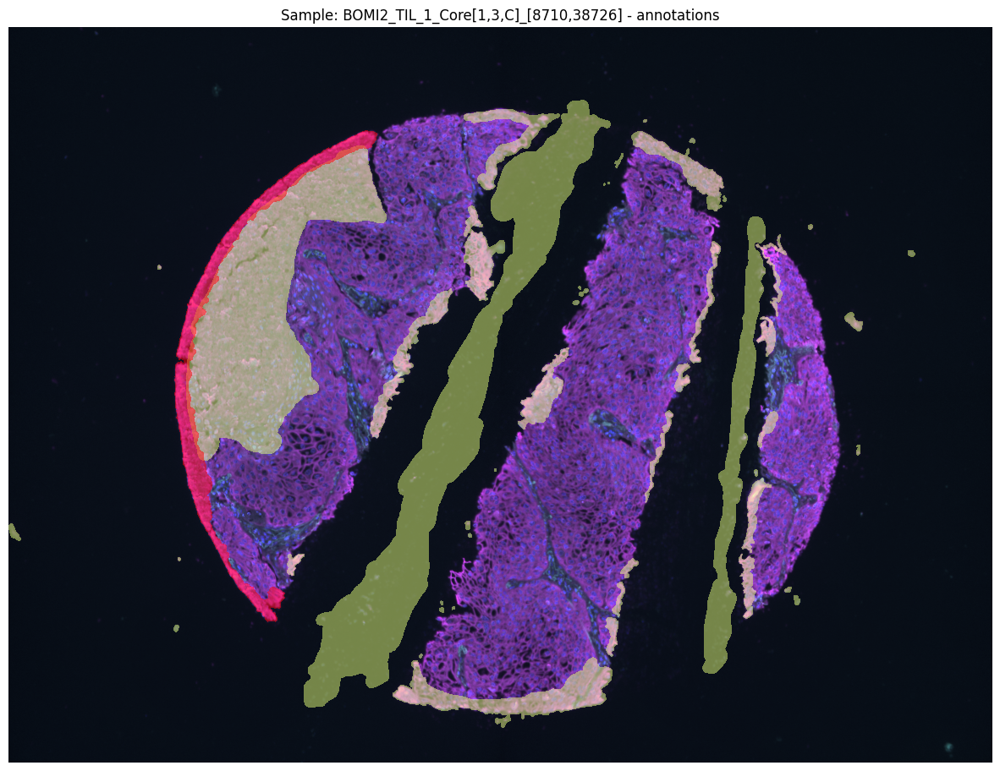

In [ ]:
print(f"Original shape: {wsi_samples[1]['original'].shape}")
print(f"Annotation (one channel) original shape: {wsi_samples[0]['annotation'][0].shape}")

plot_sample(wsi_samples[2])
plot_sample(wsi_samples[random.randint(1,len(wsi_samples))])

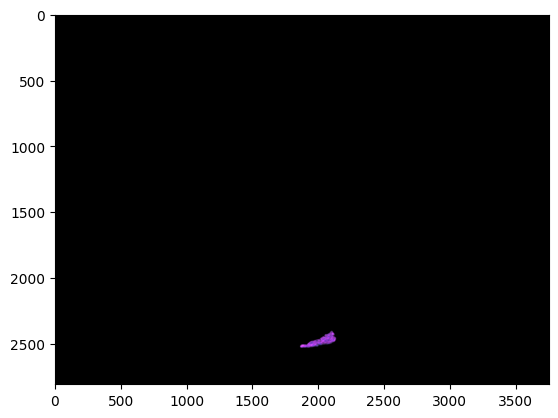

In [ ]:
plt.imshow(wsi_samples[0]['segments'][20].permute(1,2,0))

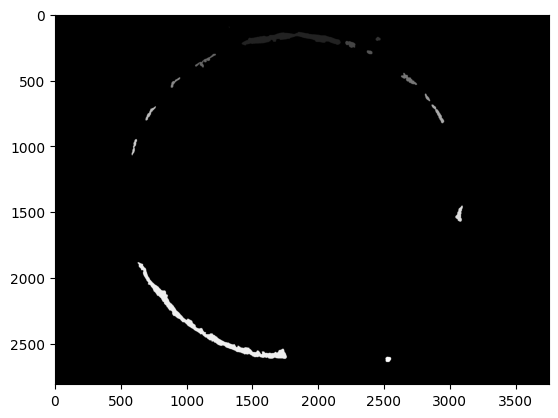

In [ ]:
labeled = measure.label(wsi_samples[1]['annotation'][0], connectivity=2)
plt.imshow(labeled, cmap="gray")

In [ ]:
print(np.unique(labeled))

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]


# 2. CLUSTERIZATION 💚

### 2.1 Saving segments

Size of new segment: torch.Size([3, 244, 244])


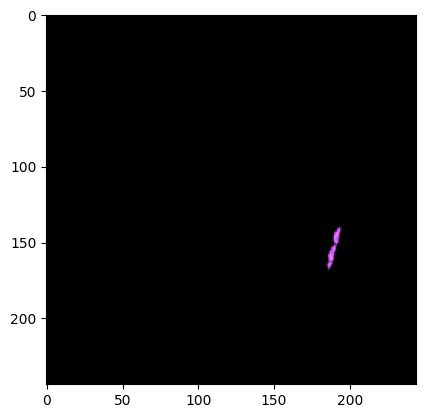

In [ ]:
right_size = F.resize(wsi_samples[0]['segments'][12], [244,244])
print(f"Size of new segment: {right_size.shape}")
plt.imshow(right_size.cpu().permute(1, 2, 0))

torch.Size([3, 244, 244])
torch.Size([244, 244])


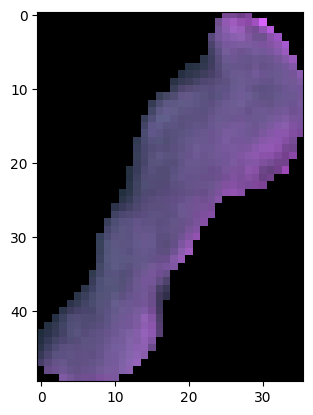

In [ ]:
print(right_size.shape)

print(right_size.sum(dim=0).shape)

non_zero_indices = torch.nonzero(wsi_samples[13]['segments'][5].sum(dim=0))
if non_zero_indices.numel() > 0:
    min_x = torch.min(non_zero_indices[:, 0]).item()
    max_x = torch.max(non_zero_indices[:, 0]).item()
    min_y = torch.min(non_zero_indices[:, 1]).item()
    max_y = torch.max(non_zero_indices[:, 1]).item()
else:
    # Handle the case when there are no non-zero indices
    min_x = max_x = min_y = max_y = 0  # or any other appropriate value

# Crop the segment based on the bounding box
cropped_segment = wsi_samples[13]['segments'][5][:, min_x:max_x+1, min_y:max_y+1]

plt.imshow(cropped_segment.cpu().permute(1, 2, 0))

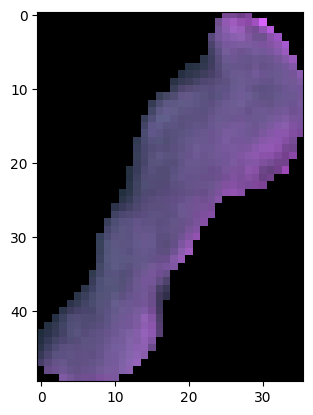

In [ ]:
image = ToPILImage()(cropped_segment)
plt.imshow(image)

In [ ]:
from torchvision.utils import save_image
output_path = '/content/drive/MyDrive/pathdata/segments_with_padding'

for i, sample in tqdm(enumerate(wsi_samples, start=89)):

    for j, segment in enumerate(wsi_samples[i]['segments']):

      # Cropping segment as bounding box
      non_zero_indices = torch.nonzero(segment.sum(dim=0))
      if non_zero_indices.numel() > 0:
          min_x = torch.min(non_zero_indices[:, 0]).item()
          max_x = torch.max(non_zero_indices[:, 0]).item()
          min_y = torch.min(non_zero_indices[:, 1]).item()
          max_y = torch.max(non_zero_indices[:, 1]).item()
      else:
          # case when there are no non-zero indices
          min_x = max_x = min_y = max_y = 0

      # Crop the segment based on the bounding box
      cropped_segment = segment[:, min_x:max_x+1, min_y:max_y+1]

      image = ToPILImage()(cropped_segment)

      # Save image to Google Drive
      image_path = os.path.join(output_path, f'{wsi_samples[i]["id"]}_seg_{j}.png')
      save_image(cropped_segment, image_path)
      #image.save(image_path)

    print(f"Saved {len(wsi_samples[i]['segments'])} segments of {wsi_samples[i]['id']}")

NameError: name 'wsi_samples' is not defined

Attempting to pad images to not crop images to their original size, but

In [ ]:
output_path = '/content/drive/MyDrive/pathdata/segments_with_padding'

max_width = 0
max_height = 0

for filename in tqdm(os.listdir(output_path)):
    if filename.endswith(".png"):
        # Load the image and get its dimensions
        image = Image.open(os.path.join(output_path, filename))
        width, height = image.size
        # Update max_width and max_height if necessary
        max_width = max(max_width, width)
        max_height = max(max_height, height)

print(max_height, max_width)

  0%|          | 0/3467 [00:00<?, ?it/s]

946 941


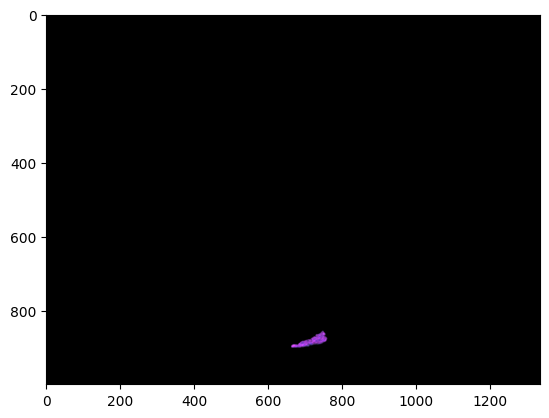

In [ ]:
seg = wsi_samples[0]['segments'][20]
plt.imshow(seg.permute(1,2,0))


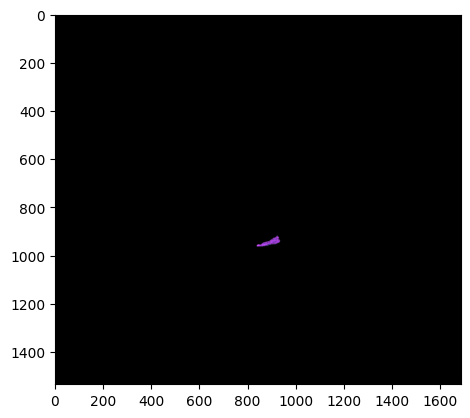

In [ ]:
def crop_center(image, m, n):
  """
  Crop the image around the center of the non-black segment to the fixed size (m, n).

  Args:
      image (torch.Tensor): Input image tensor.
      m (int): Desired height of the cropped image.
      n (int): Desired width of the cropped image.

  Returns:
      torch.Tensor: Cropped image tensor of size (m, n).
  """
  # Find the bounding box around the non-black segment
  non_zero_indices = torch.nonzero(image)
  min_x = non_zero_indices[:, 1].min().item()
  max_x = non_zero_indices[:, 1].max().item()
  min_y = non_zero_indices[:, 0].min().item()
  max_y = non_zero_indices[:, 0].max().item()

  # Calculate the center of the bounding box
  center_x = (min_x + max_x) // 2
  center_y = (min_y + max_y) // 2

  # Calculate the crop boundaries
  crop_x1 = max(center_x - n // 2, 0)
  crop_x2 = min(center_x + n // 2, image.shape[1])
  crop_y1 = max(center_y - m // 2, 0)
  crop_y2 = min(center_y + m // 2, image.shape[0])

  # Crop the image around the center
  cropped_image = image[crop_y1:crop_y2, crop_x1:crop_x2]

  # Pad the cropped image if necessary to ensure fixed size
  if cropped_image.shape[0] < m or cropped_image.shape[1] < n:
      pad_top = max((m - cropped_image.shape[0]) // 2, 0)
      pad_bottom = m - cropped_image.shape[0] - pad_top
      pad_left = max((n - cropped_image.shape[1]) // 2, 0)
      pad_right = n - cropped_image.shape[1] - pad_left
      cropped_image = torch.nn.functional.pad(cropped_image, (pad_left, pad_right, pad_top, pad_bottom))

  return cropped_image


cropped = crop_center(seg, max_height, max_width)
plt.imshow(cropped.permute(1,2,0))


In [ ]:
output_path_2 = '/content/drive/MyDrive/pathdata/segments_with_padding_non_crop'

for i, sample in tqdm(enumerate(wsi_samples, start=89)):

    for j, segment in enumerate(wsi_samples[i]['segments']):

      # Cropping segment as bounding box
      non_zero_indices = torch.nonzero(segment.sum(dim=0))
      if non_zero_indices.numel() > 0:
          min_x = torch.min(non_zero_indices[:, 0]).item()
          max_x = torch.max(non_zero_indices[:, 0]).item()
          min_y = torch.min(non_zero_indices[:, 1]).item()
          max_y = torch.max(non_zero_indices[:, 1]).item()
      else:
          # case when there are no non-zero indices
          min_x = max_x = min_y = max_y = 0

      # Crop the segment based on the bounding box
      cropped_segment = segment[:, min_x:max_x+1, min_y:max_y+1]

      image = ToPILImage()(cropped_segment)

      # Save image to Google Drive
      image_path = os.path.join(output_path_2, f'{wsi_samples[i]["id"]}_seg_{j}.png')
      save_image(cropped_segment, image_path)
      #image.save(image_path)

    print(f"Saved {len(wsi_samples[i]['segments'])} segments of {wsi_samples[i]['id']}")

In [ ]:
! ls /content/drive/MyDrive/pathdata

bin_maps      clusters	     component_data    segments		      small_segments_18px.txt
bin_maps_old  clusters_auto  seg_final_FAILED  segments_with_padding


In [ ]:
# paths = glob('/content/drive/MyDrive/pathdata/segments/*.png')
# small_segments_file = "/content/drive/MyDrive/pathdata/small_segments_18px.txt"

# with open(small_segments_file, "a") as f:

#   for i, sample in tqdm(enumerate(wsi_samples)):

#     for j, segment in enumerate(wsi_samples[i]['segments']):

#       # Cropping segment as bounding box
#       non_zero_indices = torch.nonzero(segment.sum(dim=0))
#       if non_zero_indices.numel() > 0:
#           min_x = torch.min(non_zero_indices[:, 0]).item()
#           max_x = torch.max(non_zero_indices[:, 0]).item()
#           min_y = torch.min(non_zero_indices[:, 1]).item()
#           max_y = torch.max(non_zero_indices[:, 1]).item()
#       else:
#           # case when there are no non-zero indices
#           min_x = max_x = min_y = max_y = 0

#       # Crop the segment based on the bounding box
#       cropped_segment = segment[:, min_x:max_x+1, min_y:max_y+1]
#       image_path = f'/content/drive/MyDrive/pathdata/segments/{wsi_samples[i]["id"]}_seg_{j}.png'


#       if cropped_segment.shape[1]<18 and cropped_segment.shape[2]<18:
#         print("small segment: ", image_path)
#         f.write(image_path + "\n")

#     print(f"Processed {len(wsi_samples[i]['segments'])} segments of {wsi_samples[i]['id']}")

### 2.2 Feature extraction and clustering

For each sample there is a corresponding mask with several (2 for now) channels with purpose of storing layered annotations. All annotated segments per channel are marked with one class. Algorithm includes individual labeling using ```skimage.measure.label()``` which assigns a color class to each instance. Then for each instance masked image is stored in samples collection with original size

```
From skimage docs:

  1-connectivity     2-connectivity     diagonal connection close-up

      [ ]           [ ]  [ ]  [ ]             [ ]
        |               \  |  /                 |  <- hop 2
  [ ]--[x]--[ ]      [ ]--[x]--[ ]        [x]--[ ]
        |               /  |  \             hop 1
      [ ]           [ ]  [ ]  [ ]

```

In [ ]:
paths = glob('/content/drive/MyDrive/pathdata/segments_with_padding/*.png')
excluded_paths_file = "/content/drive/MyDrive/pathdata/small_segments_18px.txt"

# Read the contents of the excluded paths file and store them in a set
with open(excluded_paths_file, "r") as f:
    excluded_paths = [line.replace("segments", "segments_with_padding") for line in f.read().splitlines()] #f.read().splitlines()


clean_paths = list(filter(lambda path: path not in excluded_paths, paths))

print(len(paths))
print(len(clean_paths))

3467
2531


In [ ]:
paths

['/content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_2_Core[1,1,G]_[15881,34511]_seg_10.png',
 '/content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_2_Core[1,1,G]_[15881,34511]_seg_11.png',
 '/content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_2_Core[1,1,G]_[15881,34511]_seg_12.png',
 '/content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_2_Core[1,1,G]_[15881,34511]_seg_13.png',
 '/content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_2_Core[1,1,G]_[15881,34511]_seg_14.png',
 '/content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_2_Core[1,1,G]_[15881,34511]_seg_15.png',
 '/content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_2_Core[1,1,G]_[15881,34511]_seg_16.png',
 '/content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_2_Core[1,1,G]_[15881,34511]_seg_17.png',
 '/content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_2_Core[1,1,G]_[15881,34511]_seg_18.png',
 '/content/drive/MyDrive/pathdata/seg

In [ ]:
from clustimage import Clustimage
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

In [ ]:
#Helper function to display instances of each cluster

def print_images_for_clusters(cl, images_per_row=10, max_rows=5):

    pathnames = cl.results['pathnames']
    results = cl.results
    labels = list(results['labels'])

    unique_labels = sorted(set(labels))

    for label in unique_labels:
        print(f"Cluster {label}:")

        # indexes of images belonging to cluster
        cluster_indices = [i for i, l in enumerate(labels) if l == label]

        num_images_to_display = min(images_per_row * max_rows, len(cluster_indices))
        num_rows = min(max_rows, -(-num_images_to_display // images_per_row))

        fig, axs = plt.subplots(num_rows, images_per_row, figsize=(images_per_row*2, num_rows*2))
        fig.suptitle(f"Samples for cluster {label}", fontsize=16)

        for i, ax in enumerate(axs.flat):
            if i < num_images_to_display:
                image_path = pathnames[cluster_indices[i]]
                image = mpimg.imread(image_path)
                ax.imshow(image)
                ax.axis('off')

        plt.tight_layout()
        plt.show()

#### **Strategy 1** :
* Feature extraction: PCA
* Clustering: Agglomerative
* Input data: with padding, small segments excluded

In [ ]:
cl_st1 = Clustimage(method="pca", grayscale=False, dim=(300, 300))
cl_st1.clean_init()
results_st1 = cl_st1.fit_transform(clean_paths, min_clust=6, max_clust=20)

[clustimage] >INFO> Cleaning previous fitted model results
[clustimage] >INFO> Cleaning previous fitted model results
[clustimage] >INFO> Reading and checking images.
[clustimage] >INFO> Reading and checking images.
[clustimage]: 100%|██████████| 2531/2531 [01:45<00:00, 23.96it/s] 
[clustimage] >INFO> Extracting features using method: [pca]
[clustimage] >INFO> Extracted features using [pca]: samples=2531, features=352
[clustimage] >INFO> Compute [tsne] embedding
[clustimage] >INFO> Cluster evaluation using the [high] feature space of the [pca] features.
[clustimage] >INFO> Saving data in memory.
[clustimage] >INFO> Fit with method=[agglomerative], metric=[euclidean], linkage=[ward]
[clustimage] >INFO> Evaluate using silhouette.
[clusteval] >INFO: 100%|██████████| 14/14 [00:01<00:00,  7.34it/s]
[clustimage] >INFO> Compute dendrogram threshold.
[clustimage] >INFO> Optimal number clusters detected: [12].
[clustimage] >INFO> Fin.
[clustimage] >INFO> Updating cluster-labels and cluster-mode

##### Plotting

[clustimage] >INFO> Create scatterplot


[pca]> [WARNING]: De parameter <label> is deprecated and will not be supported in future version.


(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': '352 Principal Components explain [95.02%] of the variance'}, xlabel='PC1 (22.7% expl.var)', ylabel='PC2 (14.1% expl.var)'>)

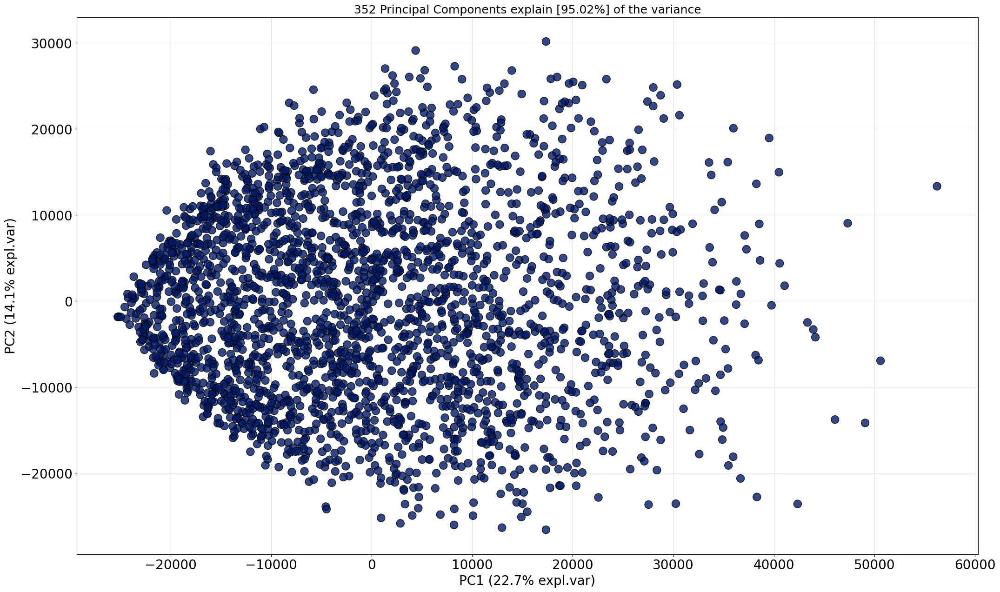

In [ ]:
cl_st1.pca.scatter(legend=False, label=False)

In [ ]:
cl_st1.results

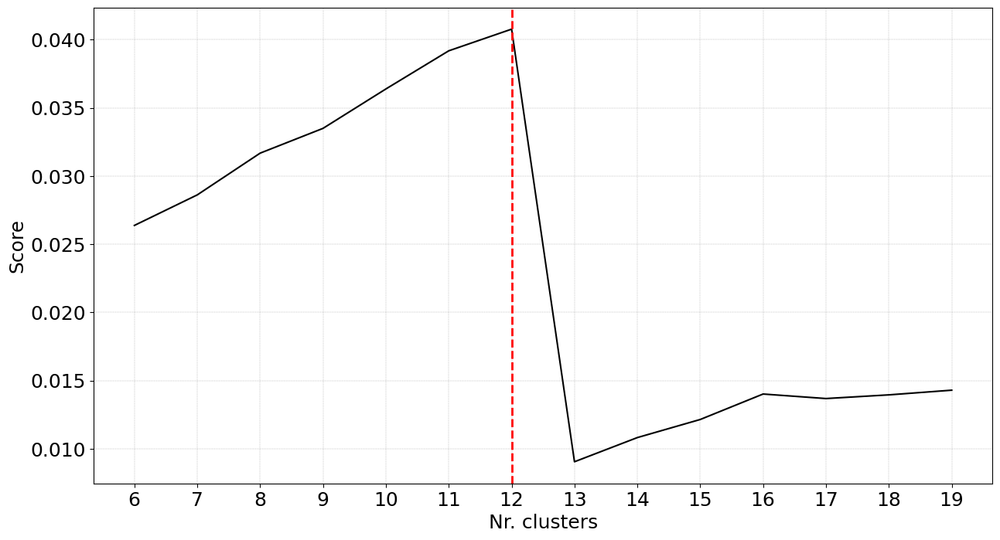

(<Figure size 1500x800 with 1 Axes>,
 <Axes: xlabel='Nr. clusters', ylabel='Score'>)

In [ ]:
cl_st1.clusteval.plot()

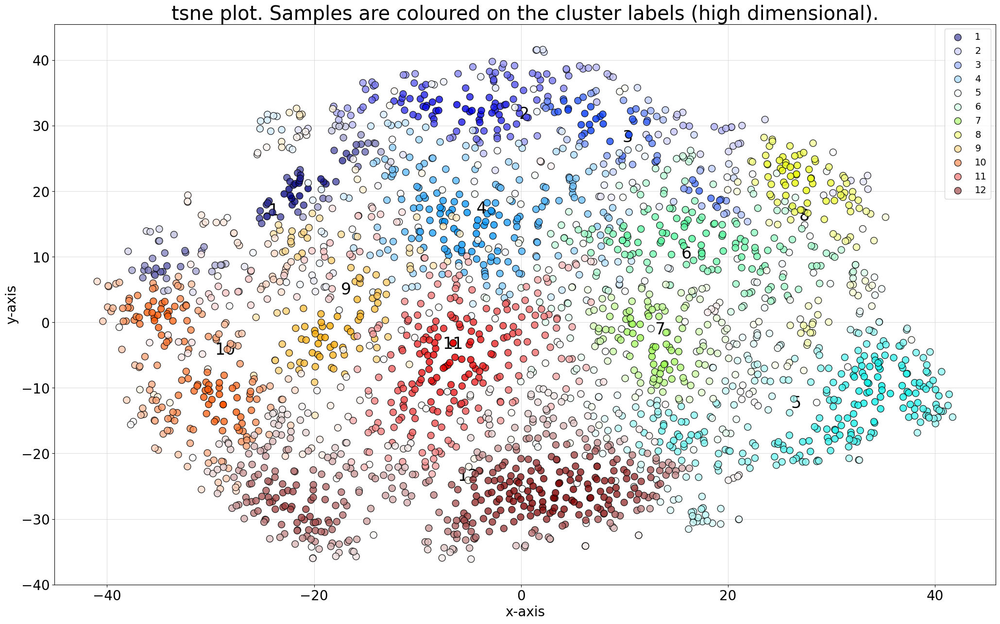

(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': 'tsne plot. Samples are coloured on the cluster labels (high dimensional).'}, xlabel='x-axis', ylabel='y-axis'>)

<Figure size 640x480 with 0 Axes>

In [ ]:
cl_st1.scatter(zoom=None, dotsize=100, figsize=(25, 15), args_scatter={'fontsize':24, 'gradient':'#FFFFFF', 'cmap':'jet', 'legend':True})

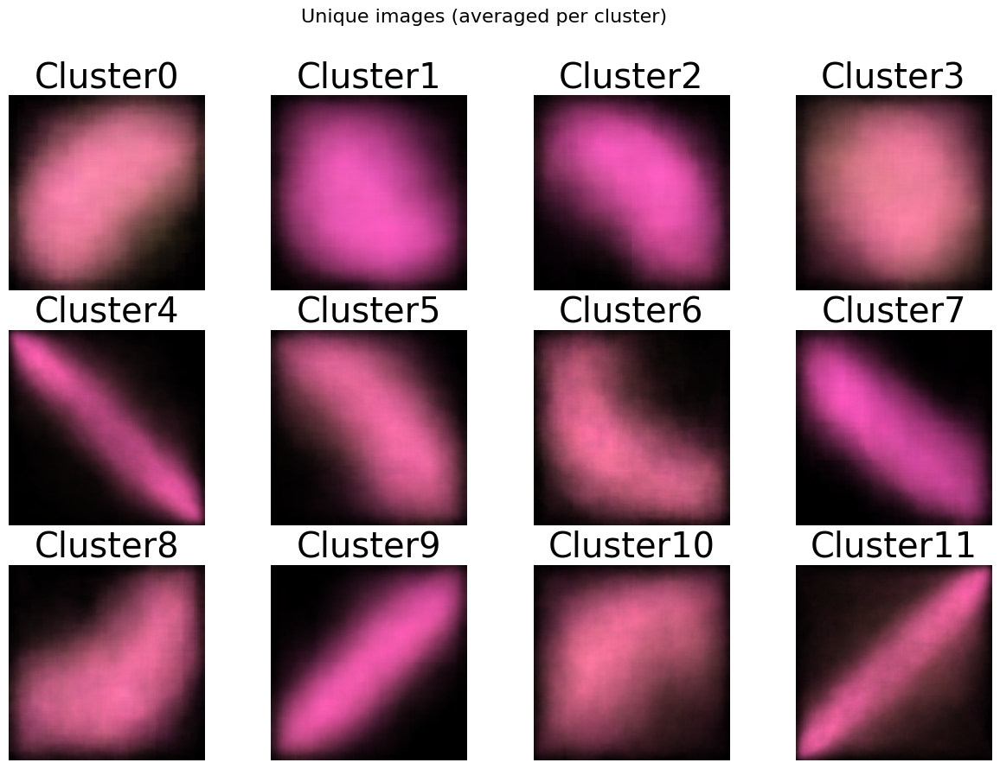

In [ ]:
cl_st1.plot_unique()

[clustimage] >INFO> Retrieving input data set.
[clustimage] >INFO> Plotting the dendrogram with optimized settings: metric=euclidean, linkage=ward, max_d=190617.460. Be patient now..
[clustimage] >INFO> Compute cluster labels.


{'icoord': [[25.0, 25.0, 35.0, 35.0],
  [15.0, 15.0, 30.0, 30.0],
  [45.0, 45.0, 55.0, 55.0],
  [22.5, 22.5, 50.0, 50.0],
  [5.0, 5.0, 36.25, 36.25],
  [75.0, 75.0, 85.0, 85.0],
  [65.0, 65.0, 80.0, 80.0],
  [125.0, 125.0, 135.0, 135.0],
  [115.0, 115.0, 130.0, 130.0],
  [105.0, 105.0, 122.5, 122.5],
  [95.0, 95.0, 113.75, 113.75],
  [72.5, 72.5, 104.375, 104.375],
  [20.625, 20.625, 88.4375, 88.4375],
  [145.0, 145.0, 155.0, 155.0],
  [165.0, 165.0, 175.0, 175.0],
  [150.0, 150.0, 170.0, 170.0],
  [185.0, 185.0, 195.0, 195.0],
  [215.0, 215.0, 225.0, 225.0],
  [205.0, 205.0, 220.0, 220.0],
  [235.0, 235.0, 245.0, 245.0],
  [212.5, 212.5, 240.0, 240.0],
  [190.0, 190.0, 226.25, 226.25],
  [275.0, 275.0, 285.0, 285.0],
  [325.0, 325.0, 335.0, 335.0],
  [315.0, 315.0, 330.0, 330.0],
  [305.0, 305.0, 322.5, 322.5],
  [295.0, 295.0, 313.75, 313.75],
  [280.0, 280.0, 304.375, 304.375],
  [265.0, 265.0, 292.1875, 292.1875],
  [255.0, 255.0, 278.59375, 278.59375],
  [208.125, 208.125, 266.796

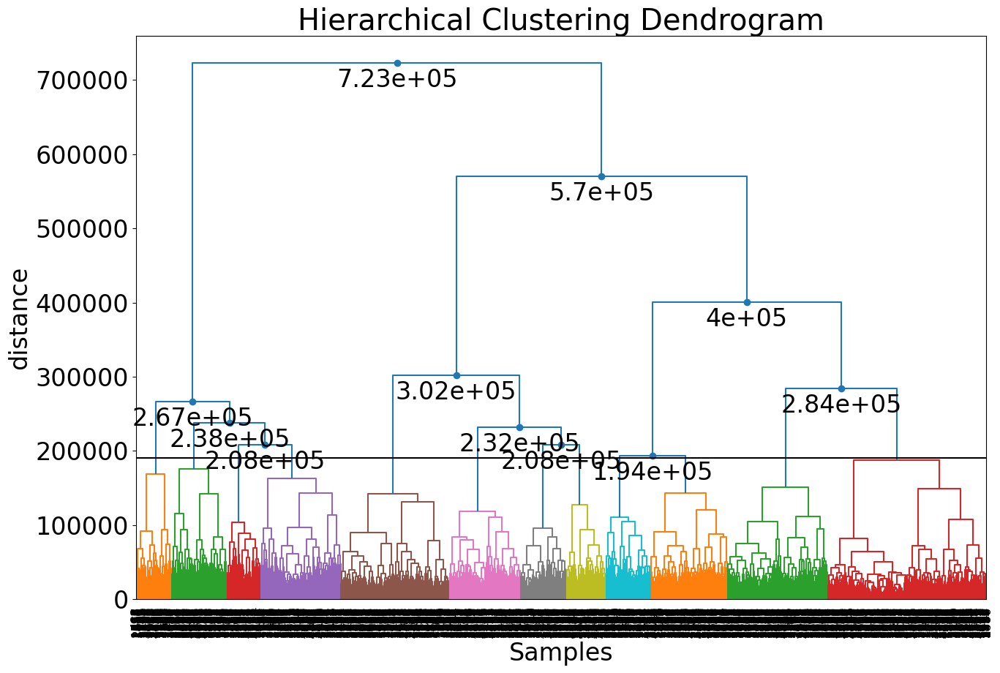

In [ ]:
cl_st1.dendrogram()

Cluster 1:


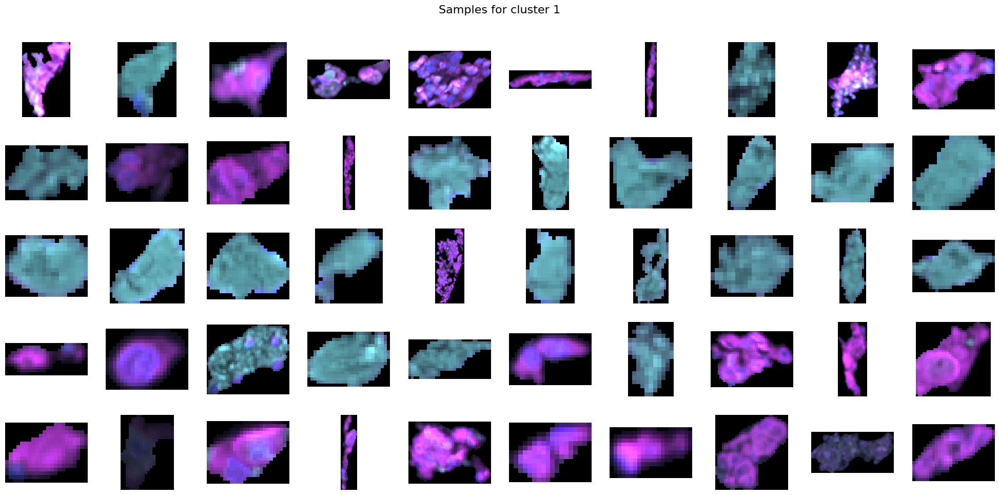

Cluster 2:


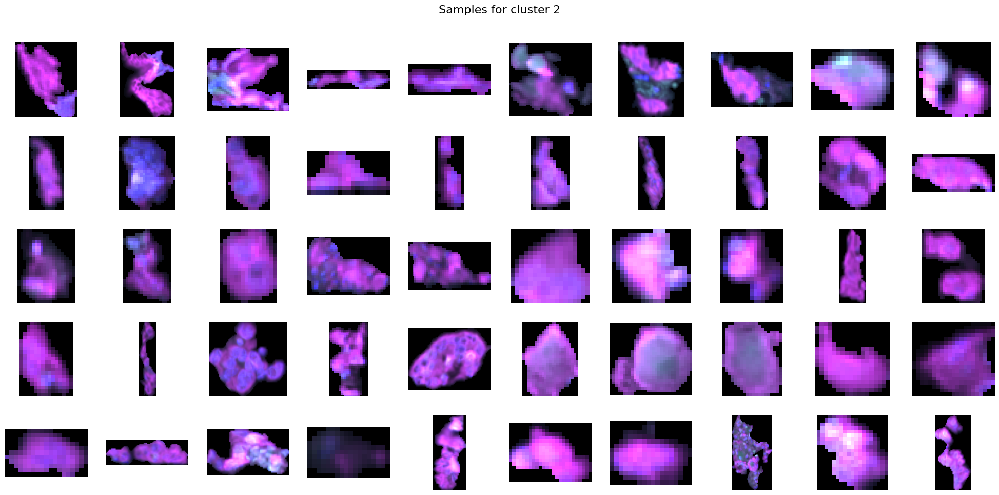

Cluster 3:


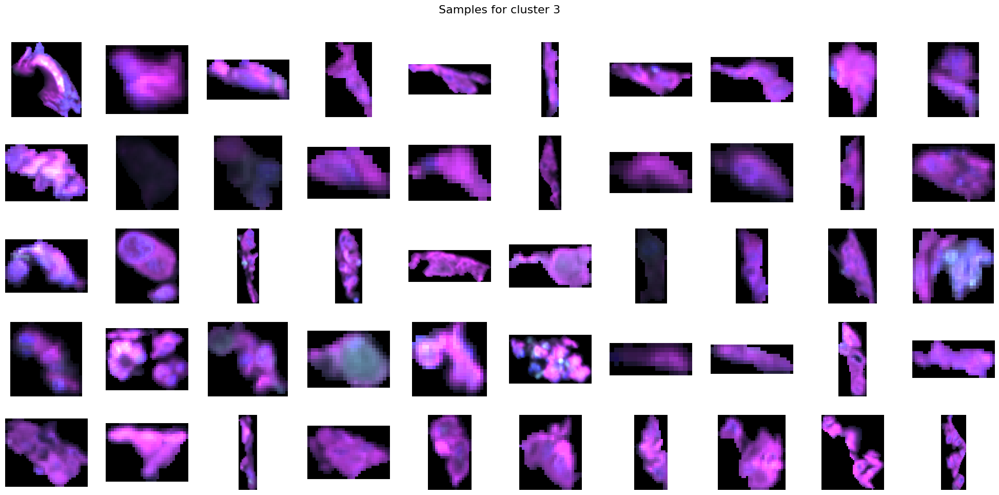

Cluster 4:


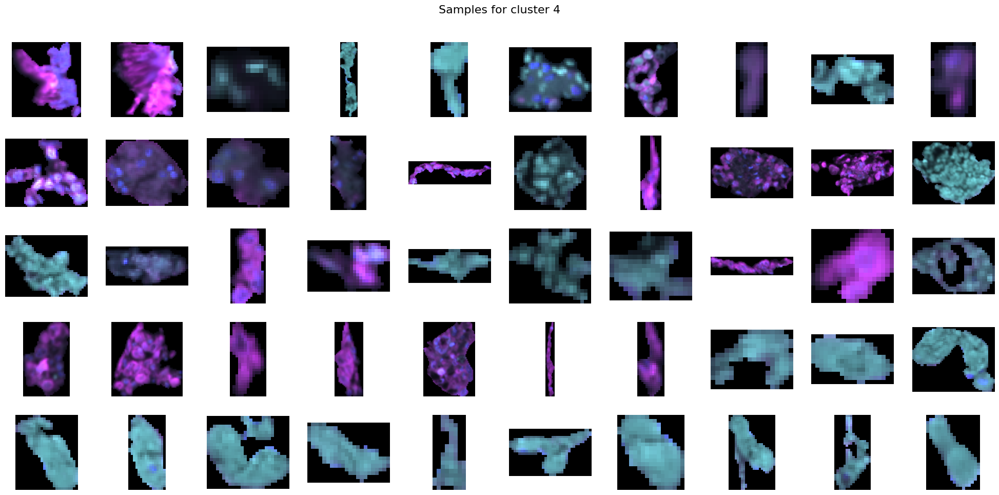

Cluster 5:


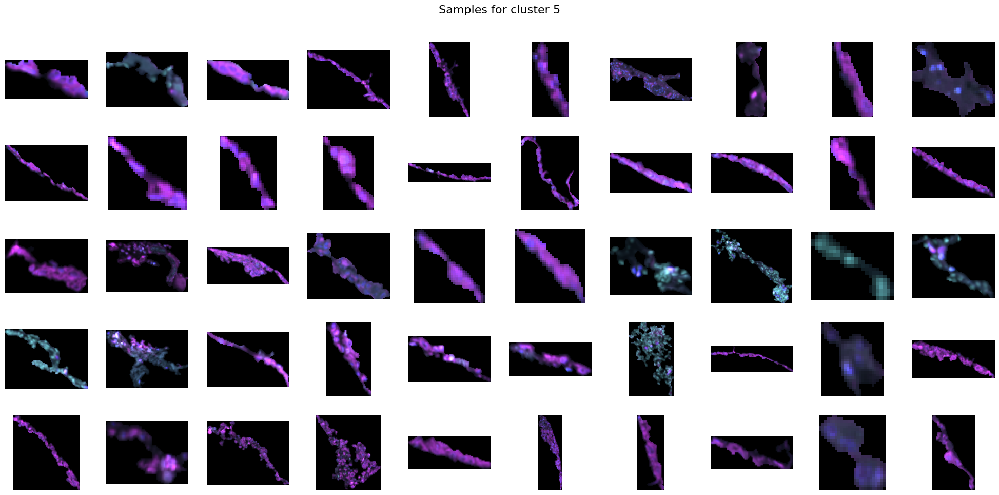

Cluster 6:


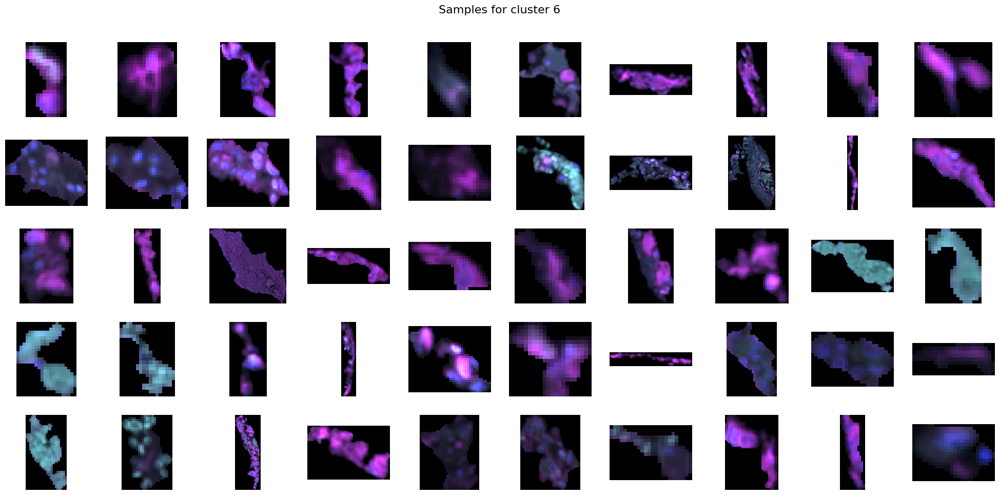

Cluster 7:


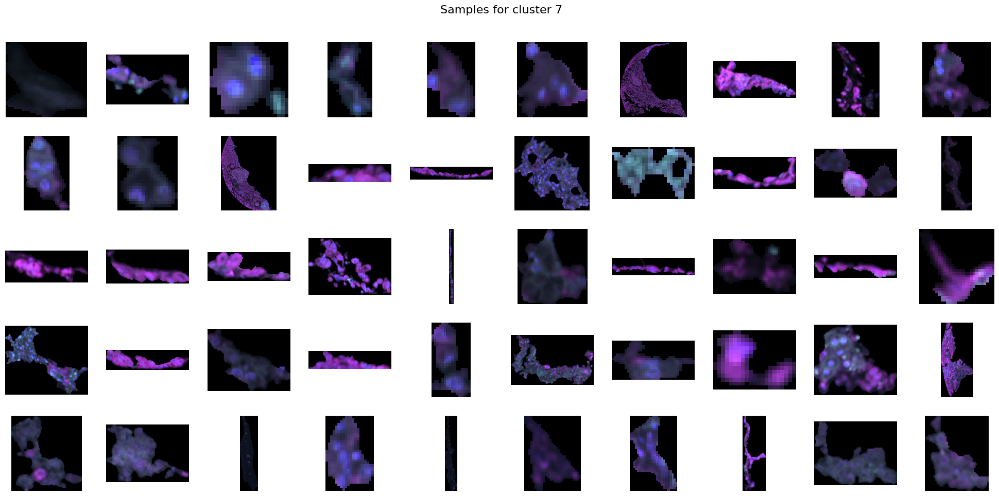

Cluster 8:


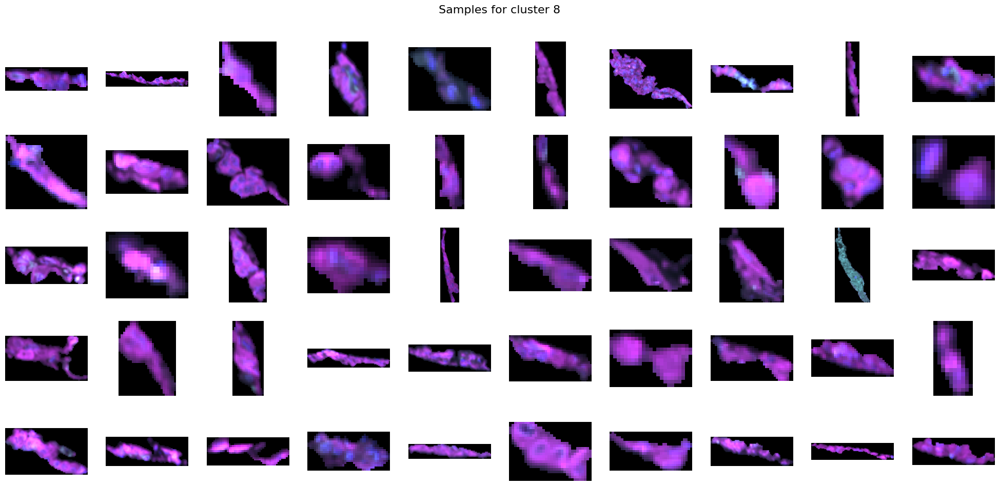

Cluster 9:


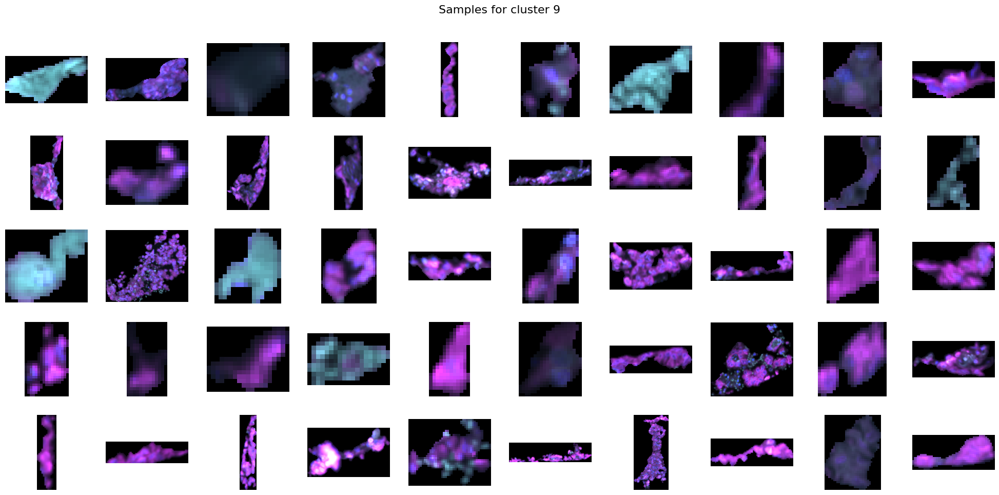

Cluster 10:


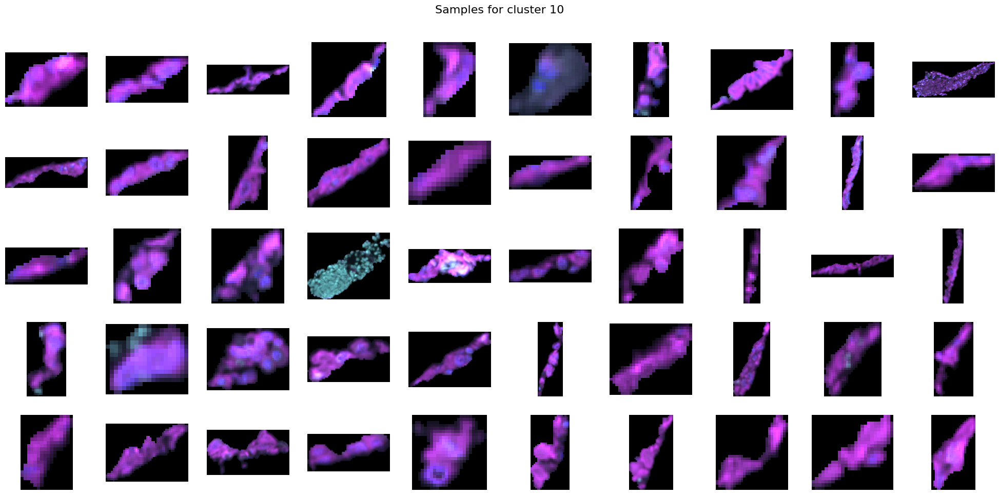

Cluster 11:


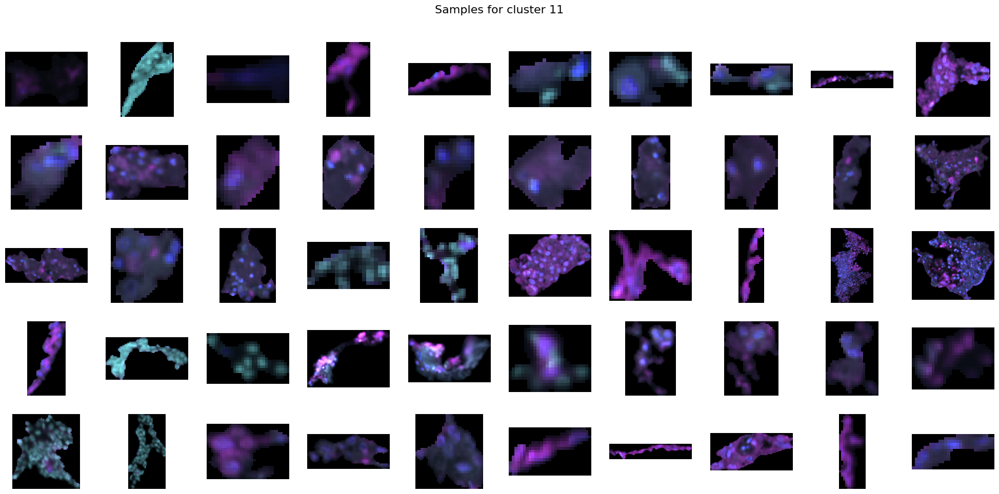

Cluster 12:


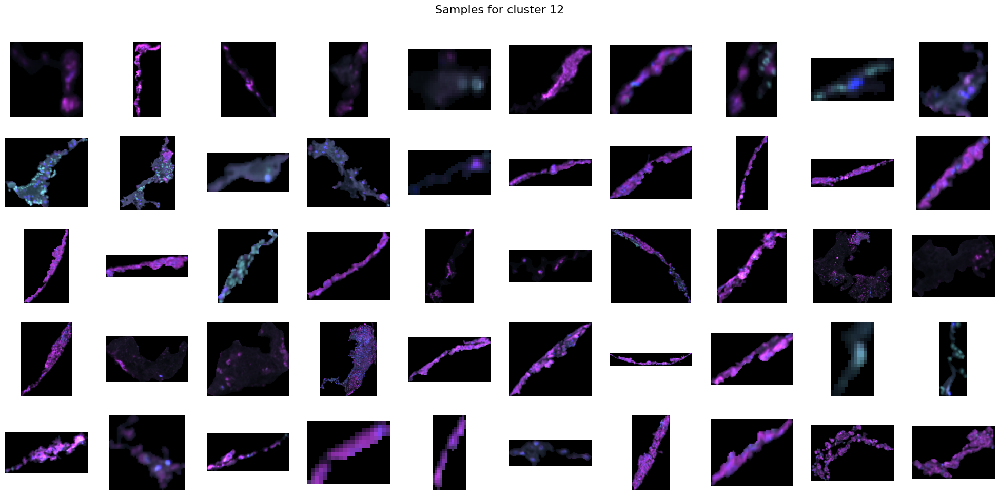

In [ ]:
print_images_for_clusters(cl_st1)

#### **Strategy 2** :
* Feature extraction: PCA
* Clustering: DBSCAN
* Input data: small samples excluded, with padding

In [ ]:
cl_st2 = Clustimage(method="pca", grayscale=False, dim=(300, 300))
cl_st2.clean_init()
results_st2 = cl_st2.fit_transform(clean_paths, min_clust=6, max_clust=20, cluster="dbscan", cluster_space='low')

#cl.cluster(cluster="dbscan", cluster_space='low', min_clust=5, max_clust=15)

[clustimage] >INFO> Cleaning previous fitted model results
[clustimage] >INFO> Cleaning previous fitted model results
[clustimage] >INFO> Reading and checking images.
[clustimage] >INFO> Reading and checking images.
[clustimage]: 100%|██████████| 2531/2531 [00:06<00:00, 365.74it/s]
[clustimage] >INFO> Extracting features using method: [pca]
[clustimage] >INFO> Extracted features using [pca]: samples=2531, features=352
[clustimage] >INFO> Compute [tsne] embedding
[clustimage] >INFO> Cluster evaluation using the [low] feature space of the [tsne] coordinates.
[clustimage] >INFO> Saving data in memory.
[clustimage] >INFO> Fit with method=[dbscan], metric=[euclidean], linkage=[ward]
[clustimage] >INFO> Gridsearch across Epsilon.
[clustimage] >INFO> Evaluate using silhouette..
[clusteval] >INFO: 100%|██████████| 245/245 [00:19<00:00, 12.51it/s]
[clustimage] >INFO> Compute dendrogram threshold.
[clustimage] >INFO> Optimal number clusters detected: [7].
[clustimage] >INFO> Fin.
[clustimage] >I

##### Plotting:

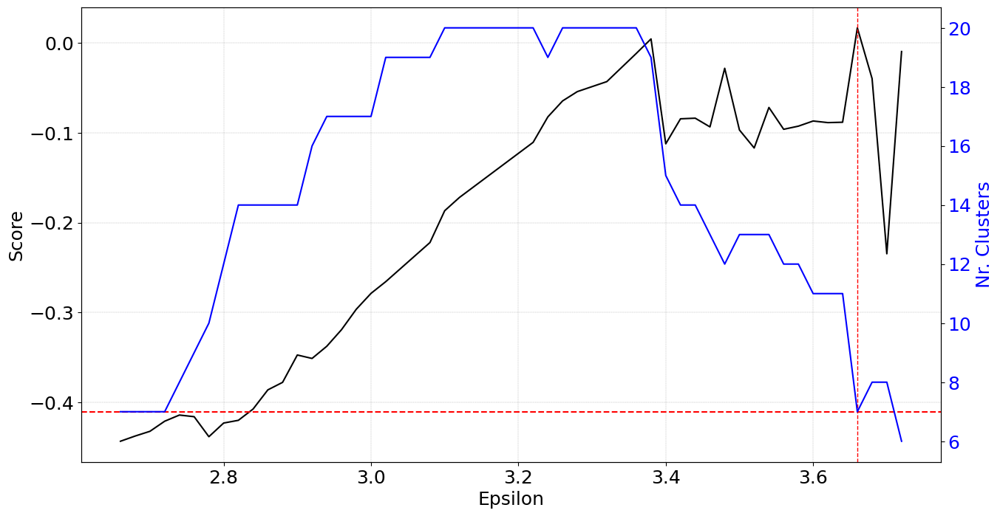

(<Figure size 1500x800 with 2 Axes>,
 (<Axes: xlabel='Epsilon', ylabel='Score'>, <Axes: ylabel='Nr. Clusters'>))

In [ ]:
cl_st2.clusteval.plot()

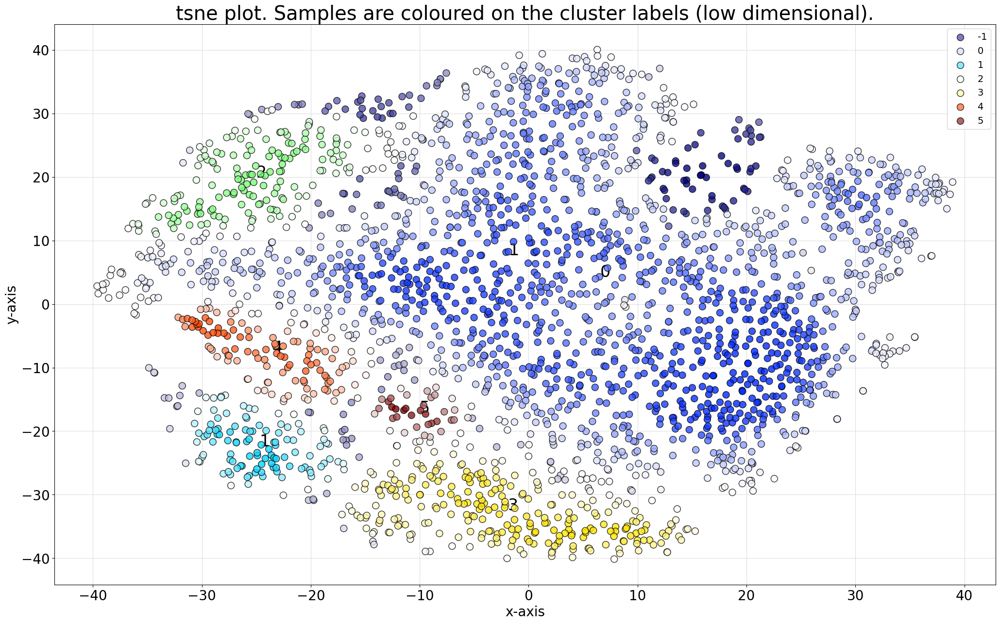

(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': 'tsne plot. Samples are coloured on the cluster labels (low dimensional).'}, xlabel='x-axis', ylabel='y-axis'>)

<Figure size 640x480 with 0 Axes>

In [ ]:
cl_st2.scatter(zoom=None, dotsize=100, figsize=(25, 15), args_scatter={'fontsize':24, 'gradient':'#FFFFFF', 'cmap':'jet', 'legend':True})


Cluster -1:


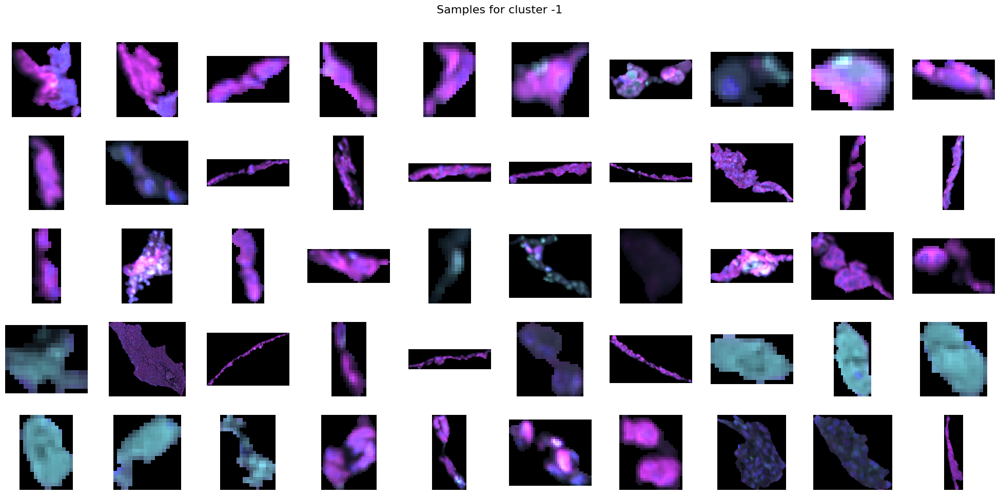

Cluster 0:


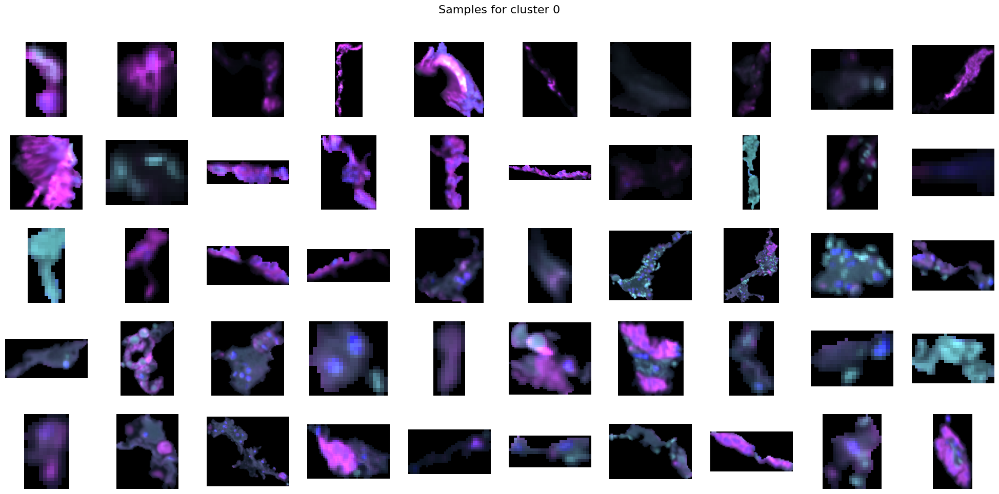

Cluster 1:


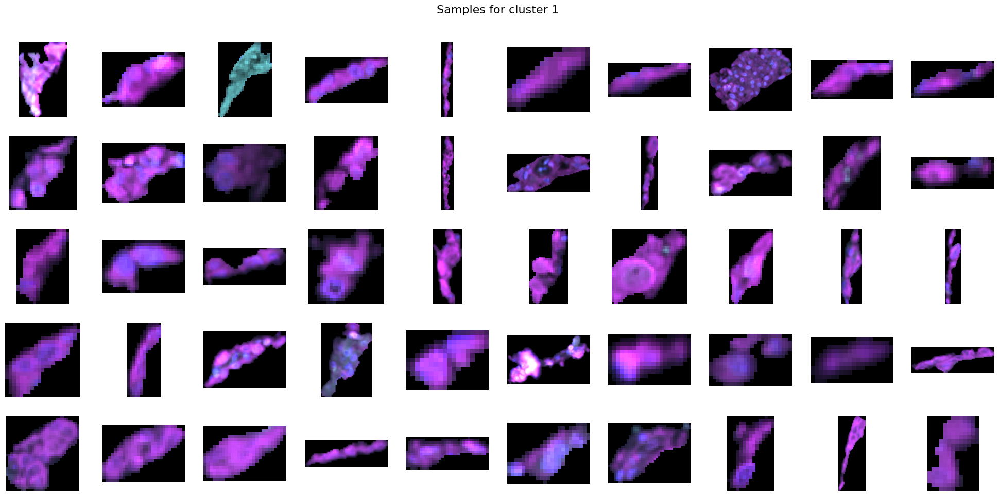

Cluster 2:


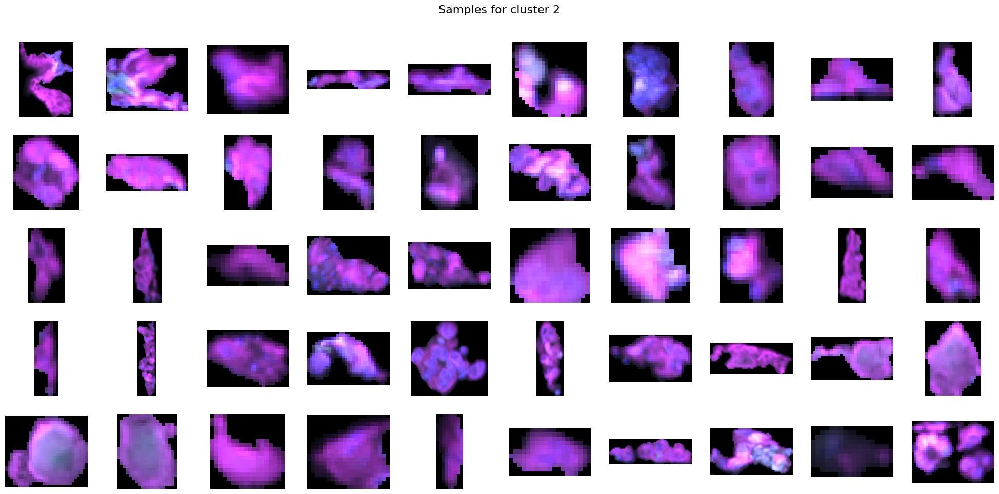

Cluster 3:


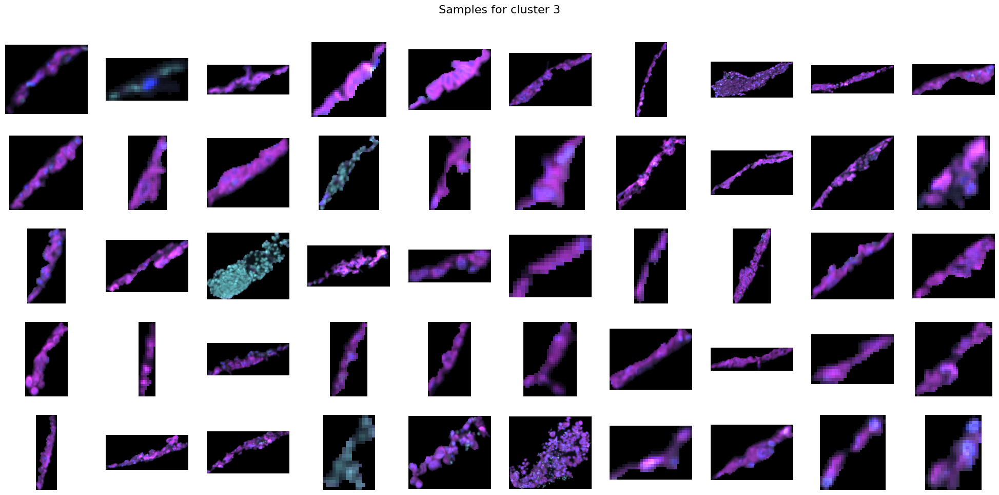

Cluster 4:


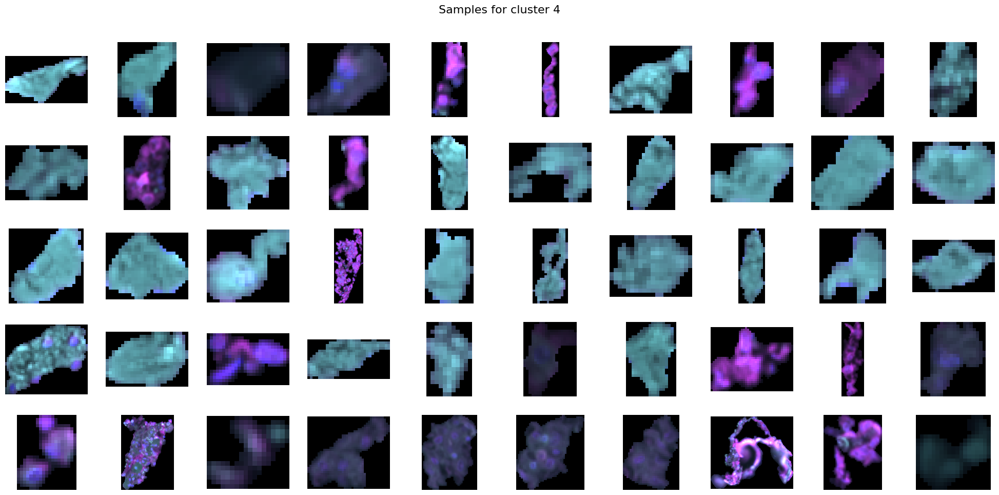

Cluster 5:


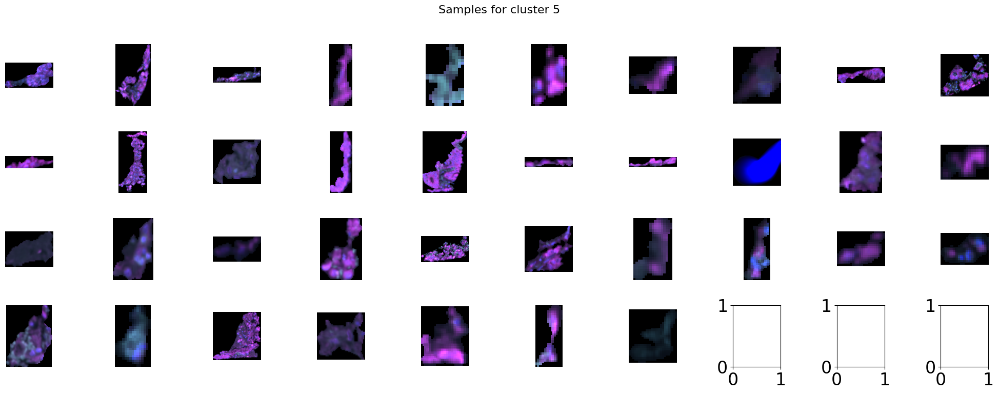

In [ ]:
print_images_for_clusters(cl_st2)

#### **Strategy 3** :
* Feature extraction : PCA-HOG
* Clustering: DBSCAN
* Cluster space: LOW
* INput data: small segments excluded, with padding

In [ ]:
cl_st3 = Clustimage(method="pca-hog", grayscale=False, dim=(300, 300))
cl_st3.clean_init()
results = cl_st3.fit_transform(clean_paths, min_clust=6, max_clust=20, cluster="dbscan", cluster_space='low')

[clusteval] >INFO> Cleaning previous fitted model results
[clusteval] >INFO> Cleaning previous fitted model results
[clusteval] >INFO> Reading and checking images.
[clusteval] >INFO> Reading and checking images.
[clustimage]: 100%|██████████| 2531/2531 [00:07<00:00, 338.76it/s]
[clusteval] >INFO> Extracting features using method: [pca-hog]
[clustimage]: 100%|██████████| 2531/2531 [24:30<00:00,  1.72it/s]
[clusteval] >INFO> Extracted features using [pca-hog]: samples=2531, features=410
[clusteval] >INFO> Compute [tsne] embedding
[clusteval] >INFO> Cluster evaluation using the [low] feature space of the [tsne] coordinates.
[clusteval] >INFO> Saving data in memory.
[clusteval] >INFO> Fit with method=[dbscan], metric=[euclidean], linkage=[ward]
[clusteval] >INFO> Gridsearch across Epsilon.
[clusteval] >INFO> Evaluate using silhouette..
[clusteval] >INFO: 100%|██████████| 245/245 [00:20<00:00, 12.15it/s]
[clusteval] >INFO> Compute dendrogram threshold.
[clusteval] >INFO> Optimal number clus

##### Plotting:

[clusteval] >INFO> Add transparency to RGB colors (last column)
[clusteval] >INFO> Create scatterplot


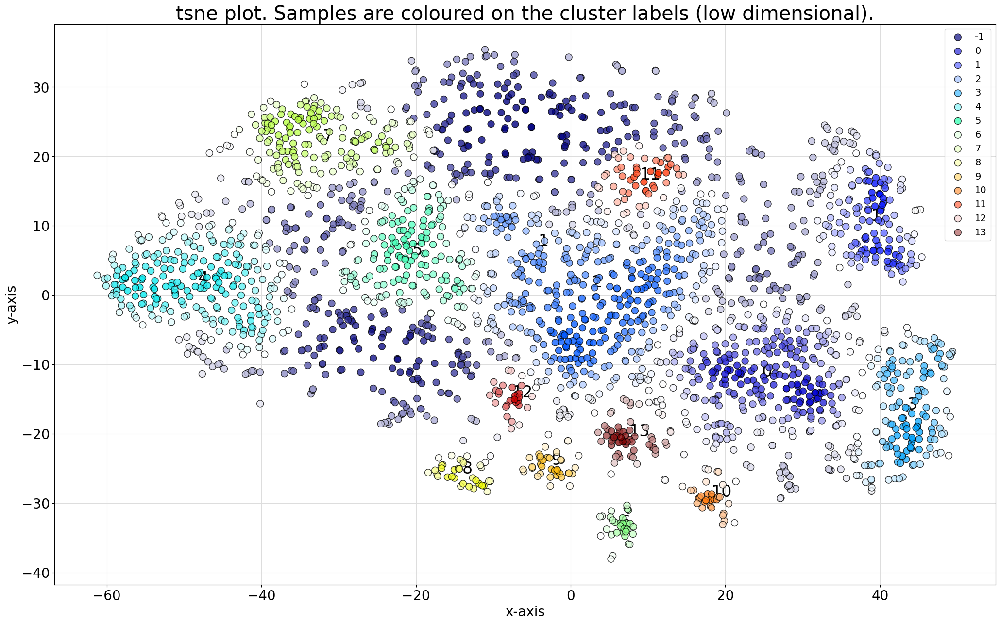

(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': 'tsne plot. Samples are coloured on the cluster labels (low dimensional).'}, xlabel='x-axis', ylabel='y-axis'>)

<Figure size 640x480 with 0 Axes>

In [ ]:
cl_st3.scatter(zoom=None, dotsize=100, figsize=(25, 15), args_scatter={'fontsize':24, 'gradient':'#FFFFFF', 'cmap':'jet', 'legend':True})

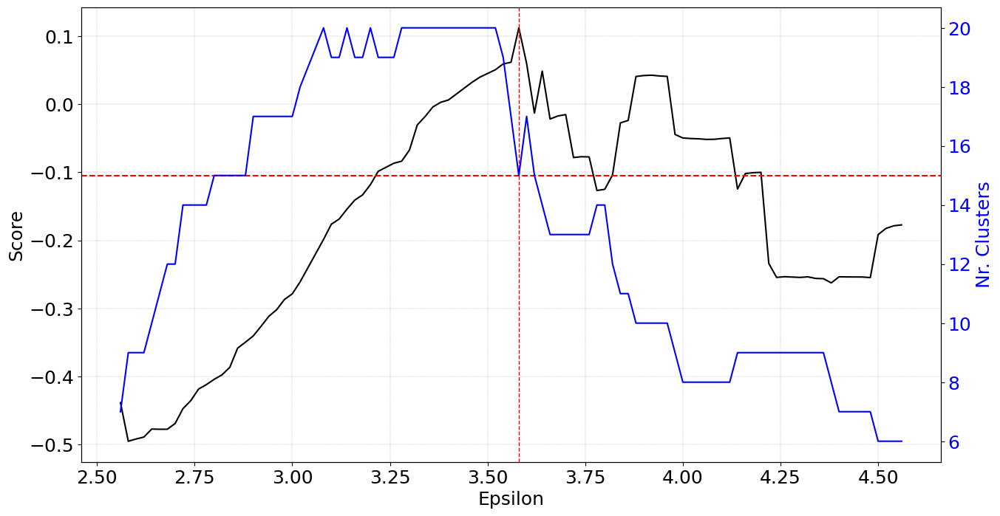

(<Figure size 1500x800 with 2 Axes>,
 (<Axes: xlabel='Epsilon', ylabel='Score'>, <Axes: ylabel='Nr. Clusters'>))

In [ ]:
cl_st3.clusteval.plot()

Cluster -1:


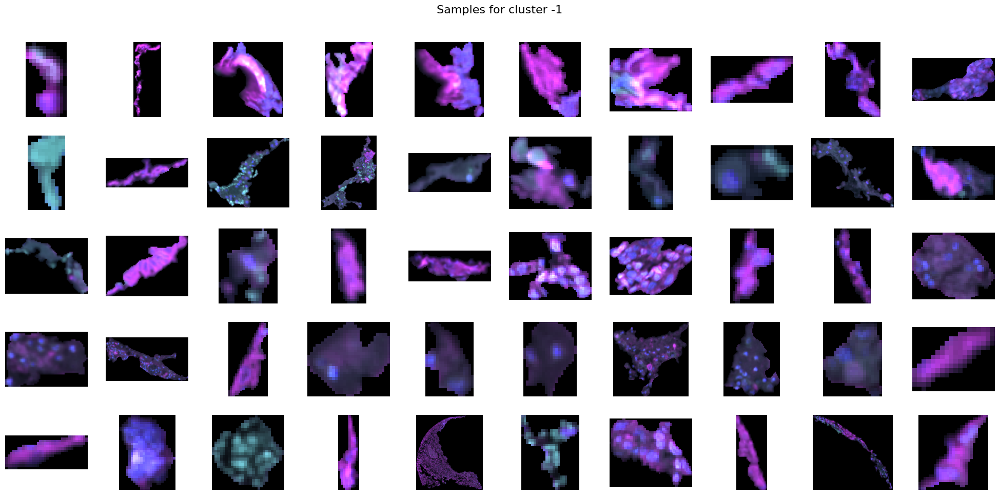

Cluster 0:


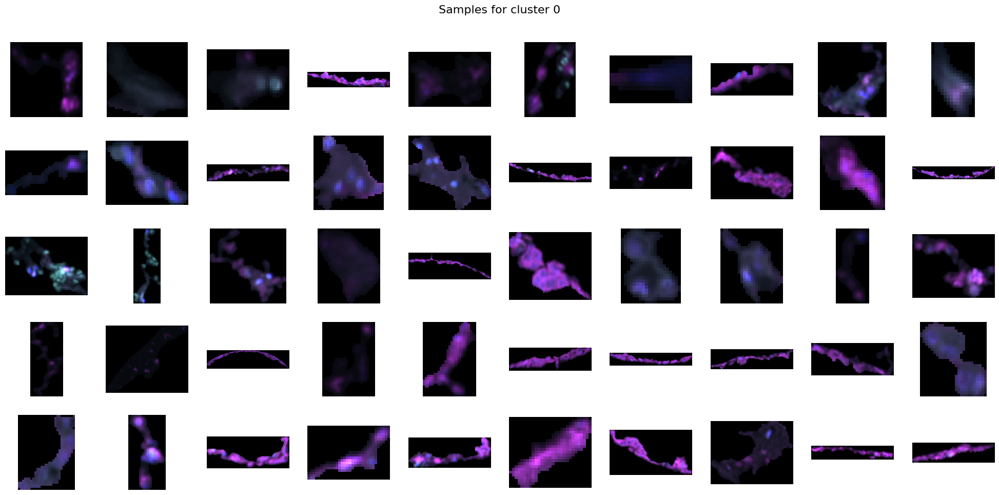

Cluster 1:


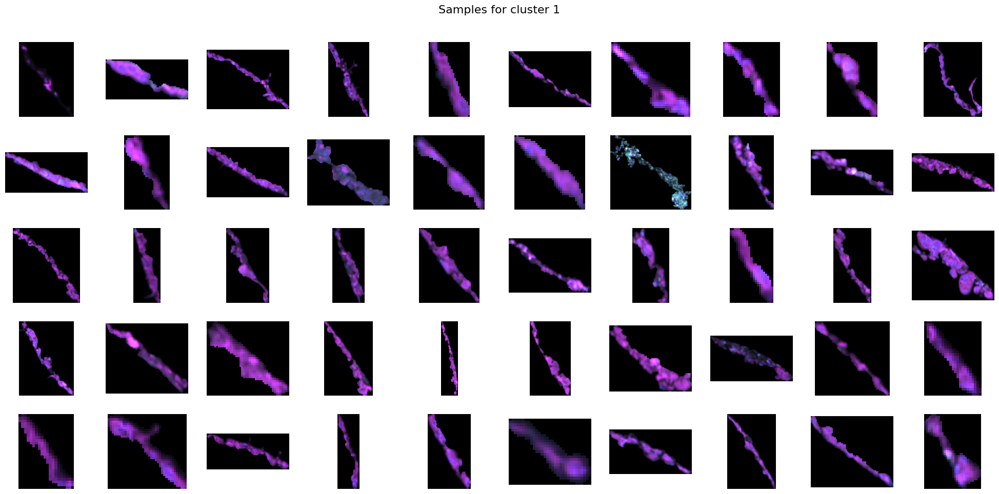

Cluster 2:


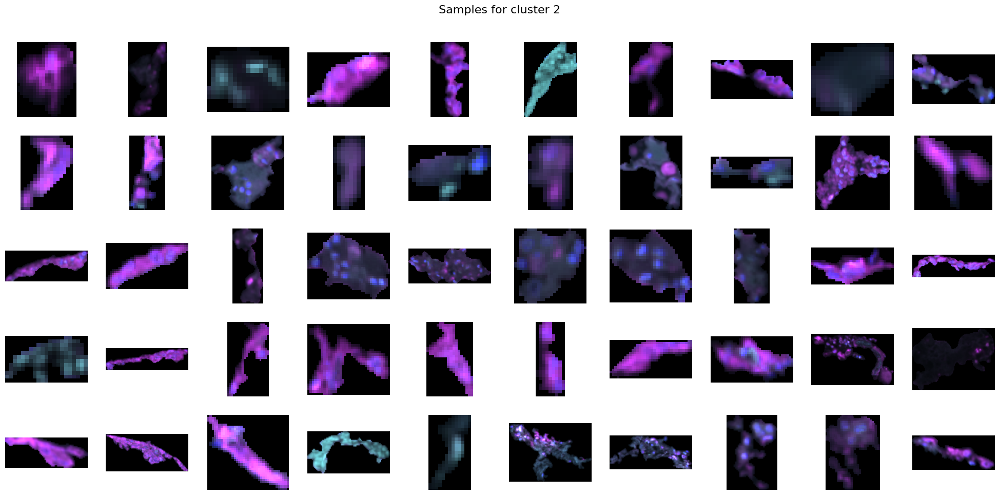

Cluster 3:


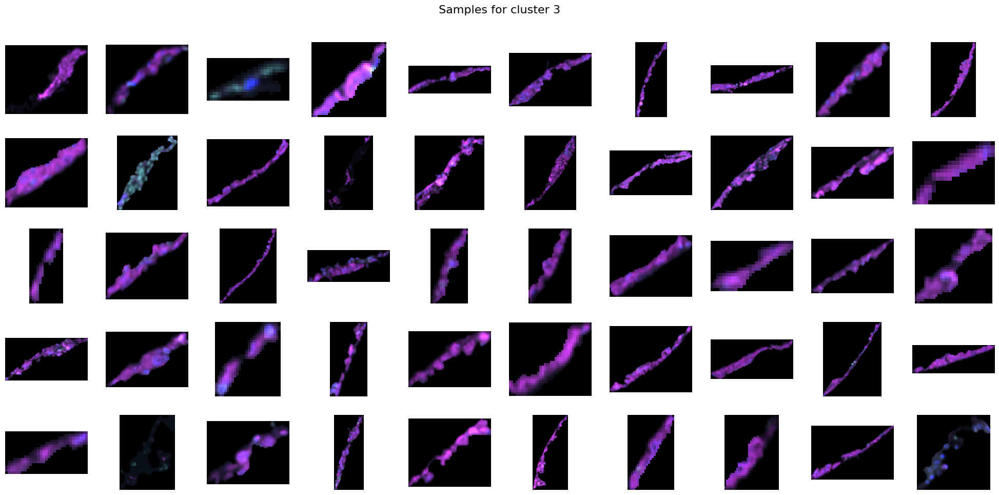

Cluster 4:


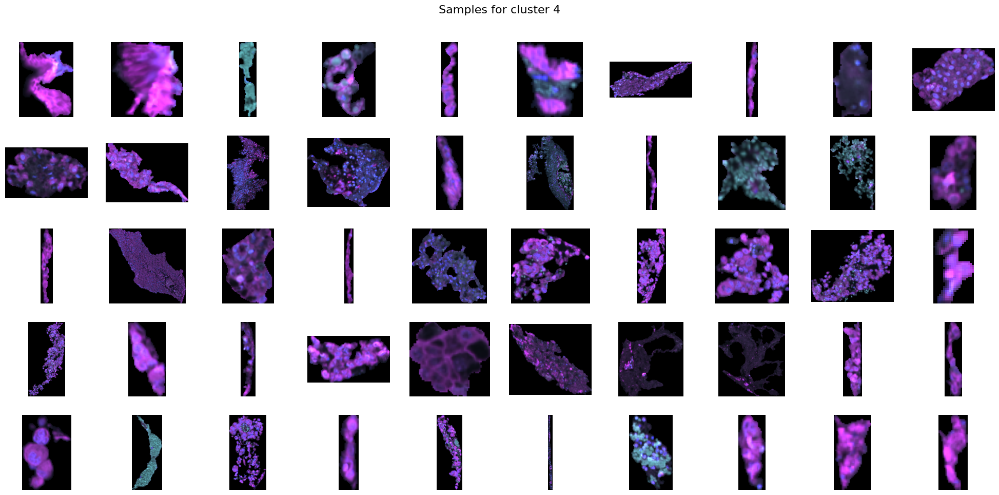

Cluster 5:


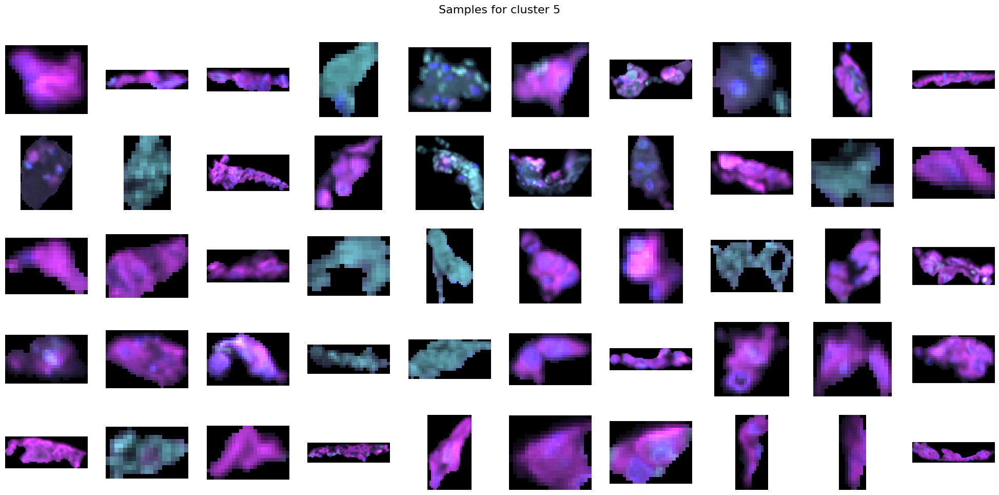

Cluster 6:


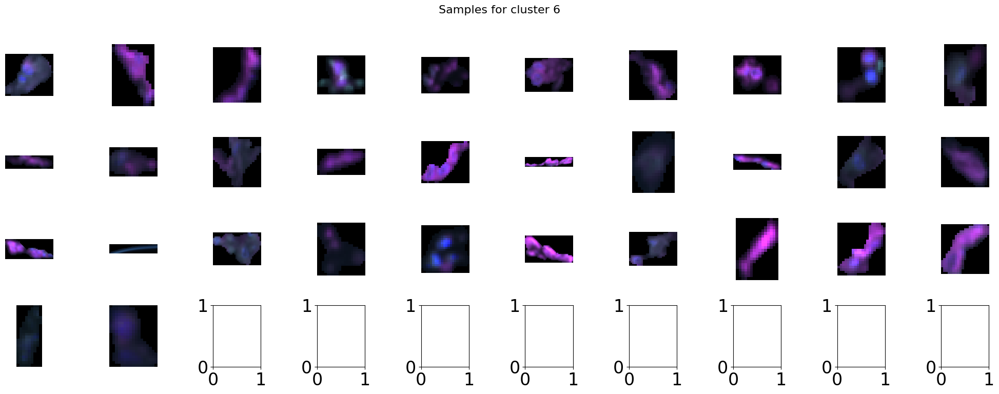

Cluster 7:


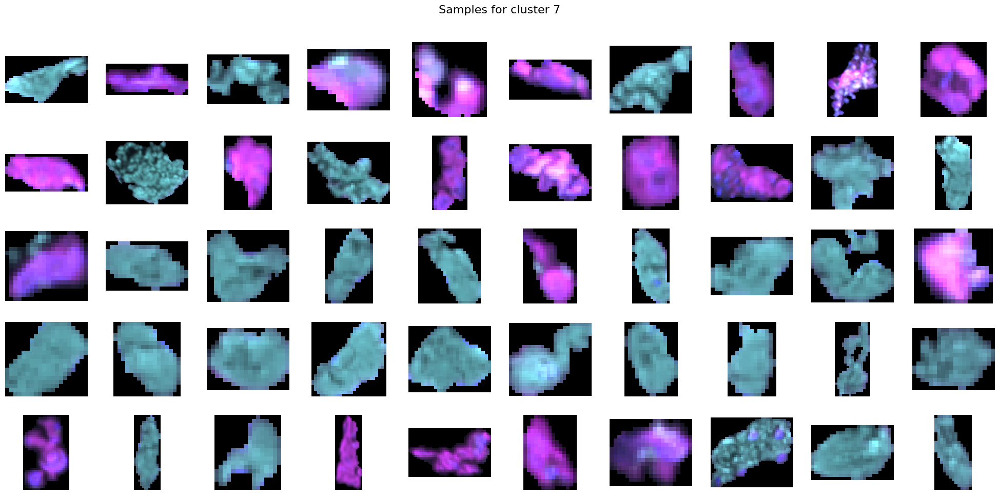

Cluster 8:


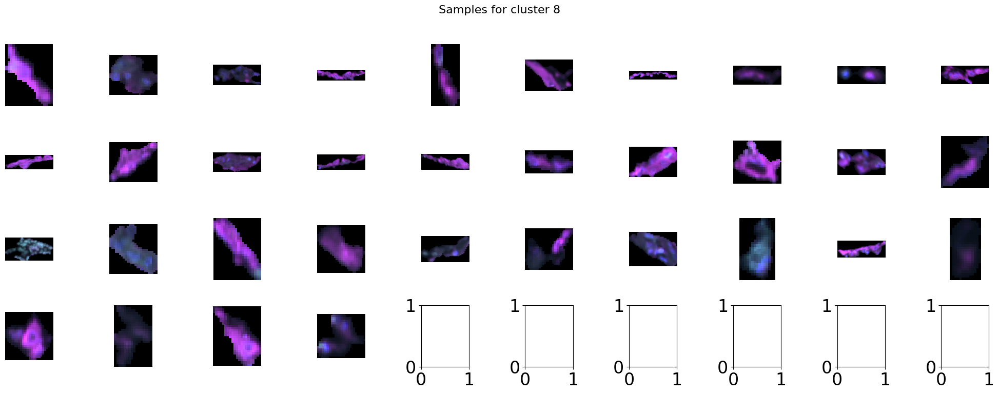

Cluster 9:


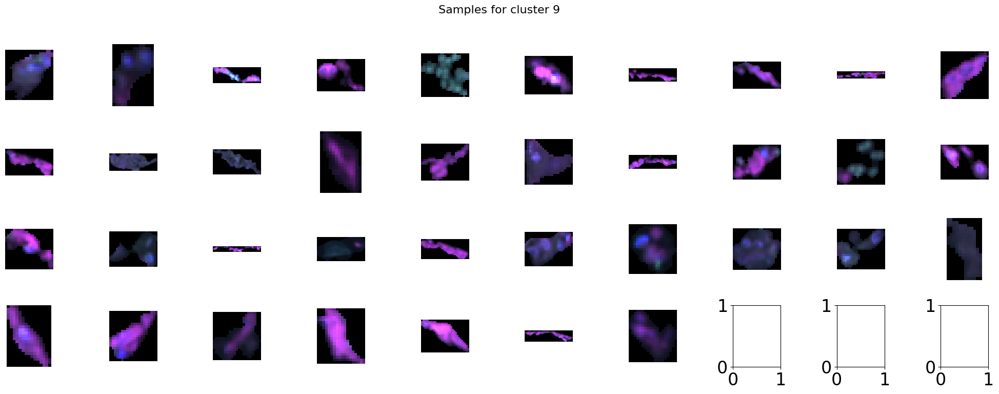

Cluster 10:


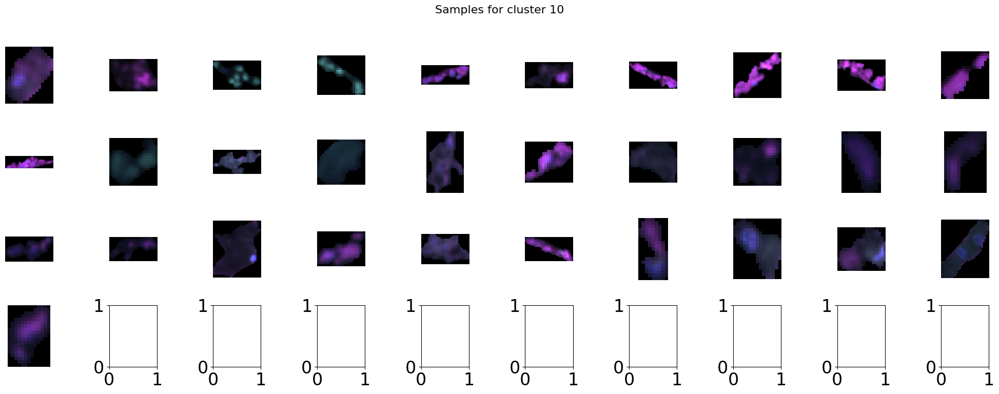

Cluster 11:


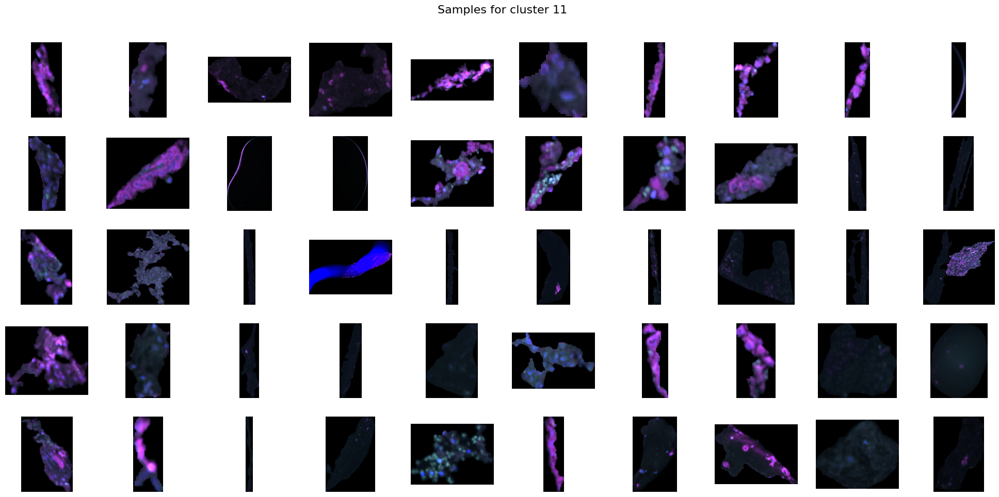

Cluster 12:


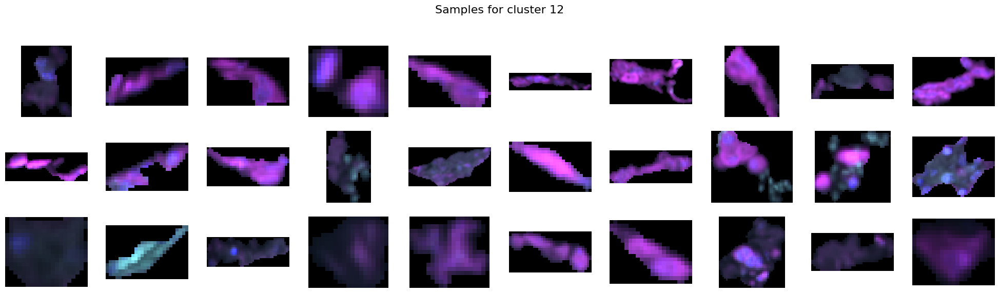

Cluster 13:


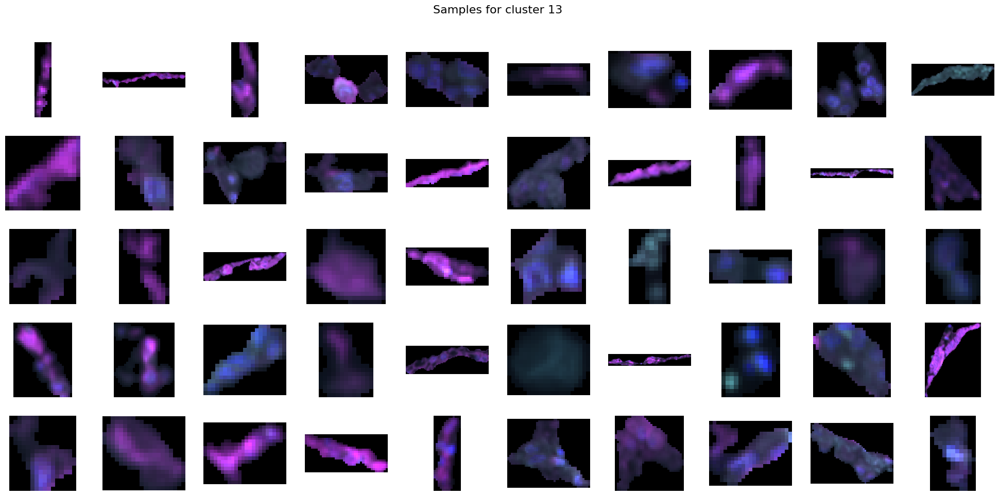

In [ ]:
print_images_for_clusters(cl_st3)

#### **Strategy 4** :

In [ ]:
cl_st4 = Clustimage(method="pca-hog", grayscale=False, dim=(300, 300))
cl_st4.clean_init()
results = cl_st4.fit_transform(clean_paths, min_clust=8, max_clust=8, cluster="kmeans", metric="sqeuclidean")

[clusteval] >INFO> Cleaning previous fitted model results
[clusteval] >INFO> Cleaning previous fitted model results
[clusteval] >INFO> Reading and checking images.
[clusteval] >INFO> Reading and checking images.
[clustimage]: 100%|██████████| 2531/2531 [00:07<00:00, 345.32it/s]
[clusteval] >INFO> Extracting features using method: [pca-hog]
[clustimage]: 100%|██████████| 2531/2531 [24:40<00:00,  1.71it/s]
[clusteval] >INFO> Extracted features using [pca-hog]: samples=2531, features=410
[clusteval] >INFO> Compute [tsne] embedding
[clusteval] >INFO> Cluster evaluation using the [high] feature space of the [pca-hog] features.
[clusteval] >INFO> Saving data in memory.
[clusteval] >INFO> Fit with method=[kmeans], metric=[sqeuclidean], linkage=[ward]
[clusteval] >INFO> Evaluate using silhouette.
[clusteval] >INFO: 100%|██████████| 1/1 [00:01<00:00,  1.73s/it]
[clusteval] >INFO> Optimal number clusters detected: [8].
[clusteval] >INFO> Fin.
[clusteval] >INFO> Updating cluster-labels and cluste

(<Figure size 1500x1000 with 1 Axes>,
 <Axes: title={'center': 'Cumulative explained variance\n 410 Principal Components explain [95.02%] of the variance.'}, xlabel='Principle Component', ylabel='Percentage explained variance'>)

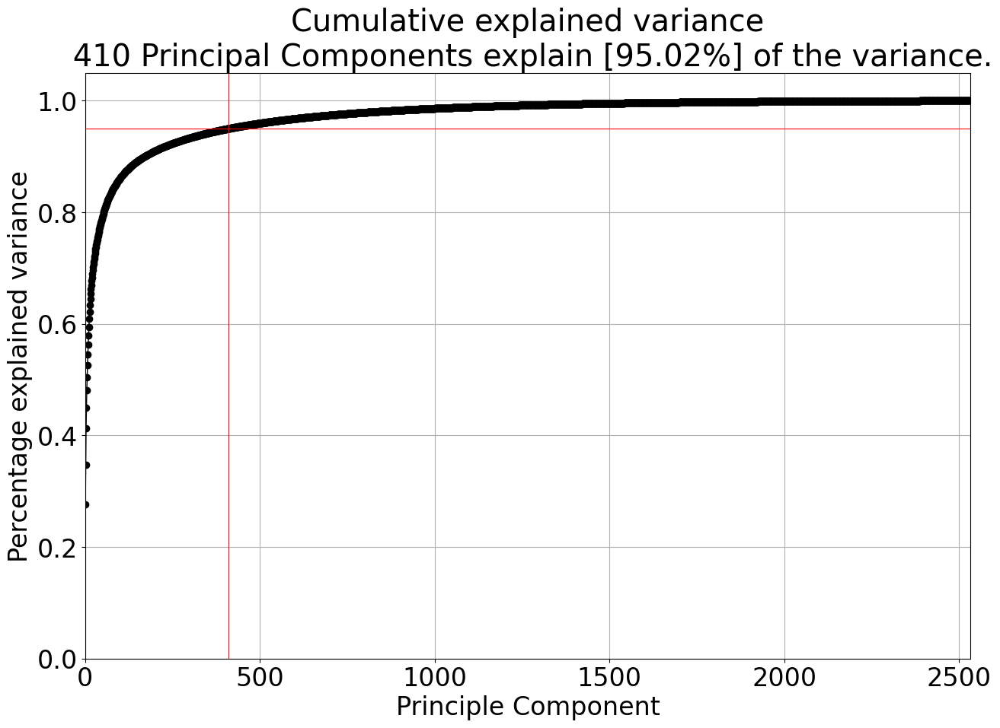

In [ ]:
cl_st4.pca.plot()

##### Plotting:

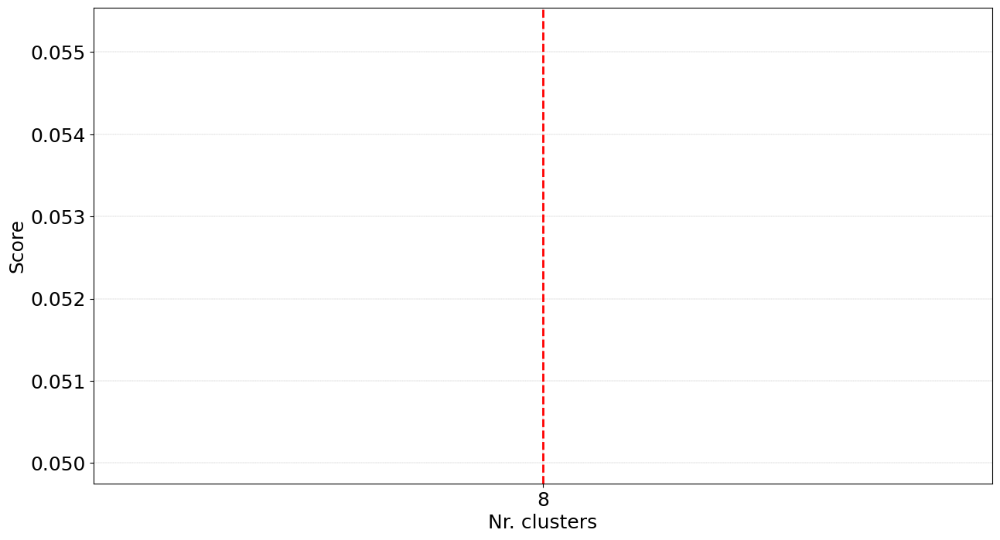

(<Figure size 1500x800 with 1 Axes>,
 <Axes: xlabel='Nr. clusters', ylabel='Score'>)

In [ ]:
cl_st4.clusteval.plot()

[clusteval] >INFO> Add transparency to RGB colors (last column)
[clusteval] >INFO> Create scatterplot


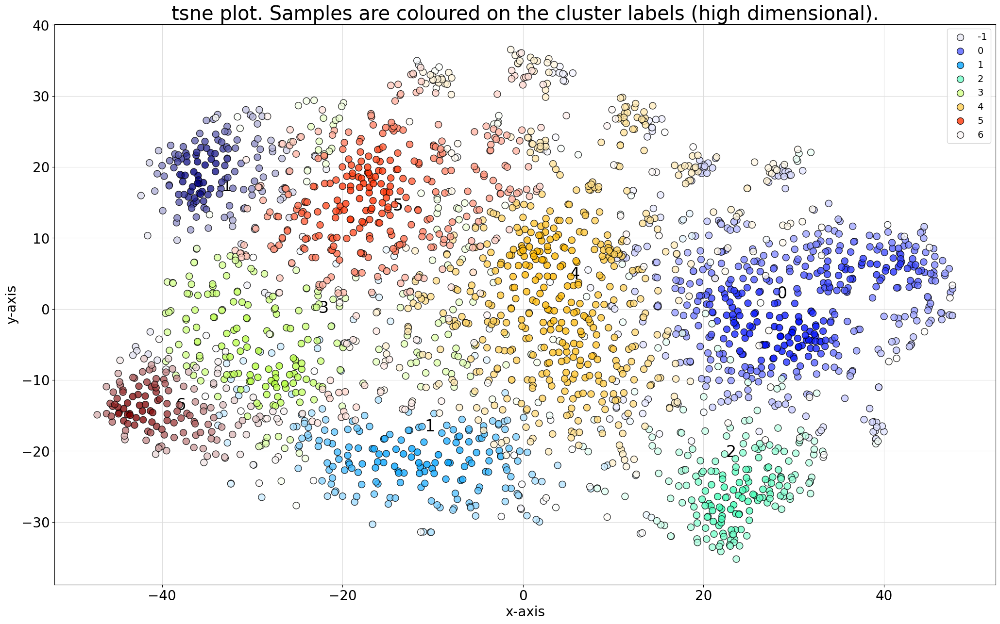

(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': 'tsne plot. Samples are coloured on the cluster labels (high dimensional).'}, xlabel='x-axis', ylabel='y-axis'>)

<Figure size 640x480 with 0 Axes>

In [ ]:
cl_st4.scatter(zoom=None, dotsize=100, figsize=(25, 15), args_scatter={'fontsize':24, 'gradient':'#FFFFFF', 'cmap':'jet', 'legend':True})

Cluster -1:


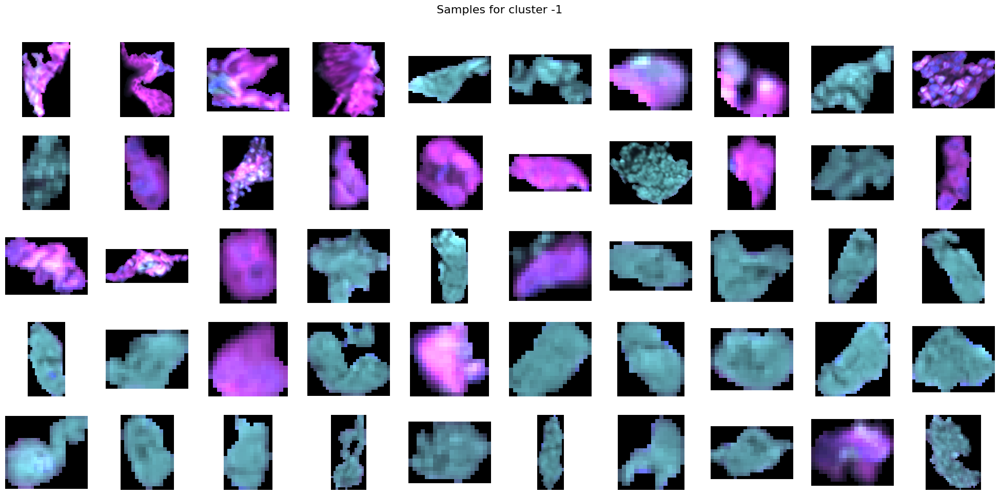

Cluster 0:


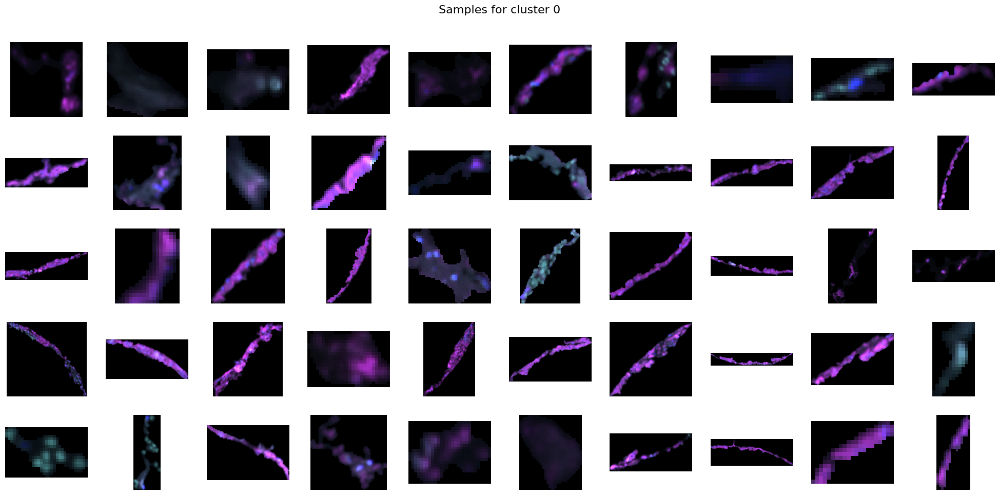

Cluster 1:


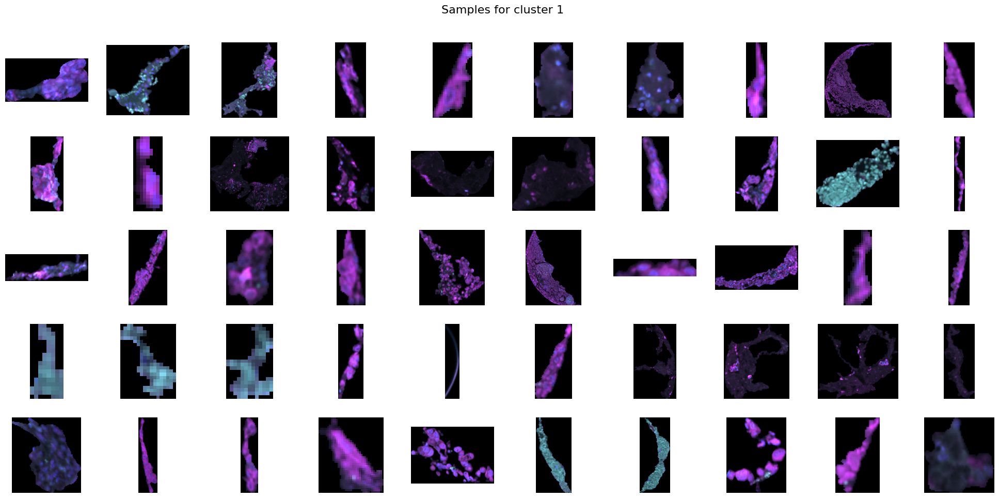

Cluster 2:


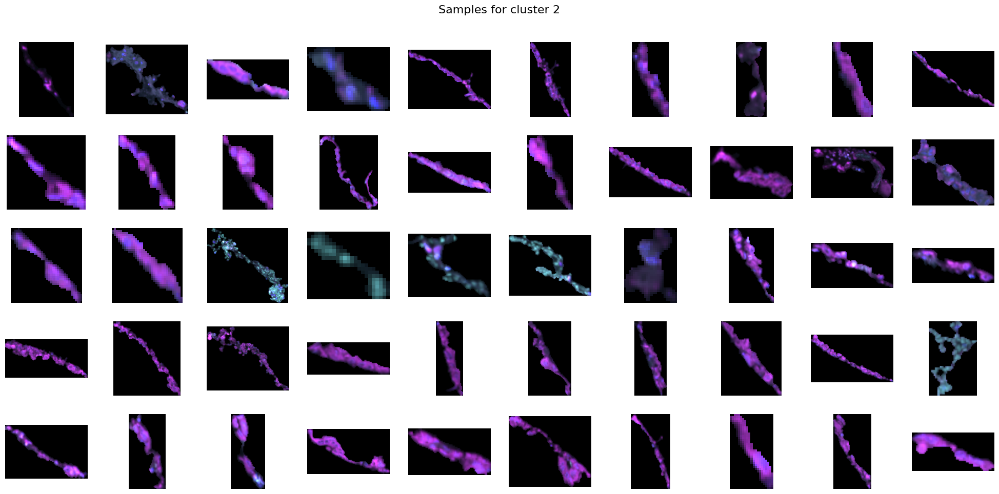

Cluster 3:


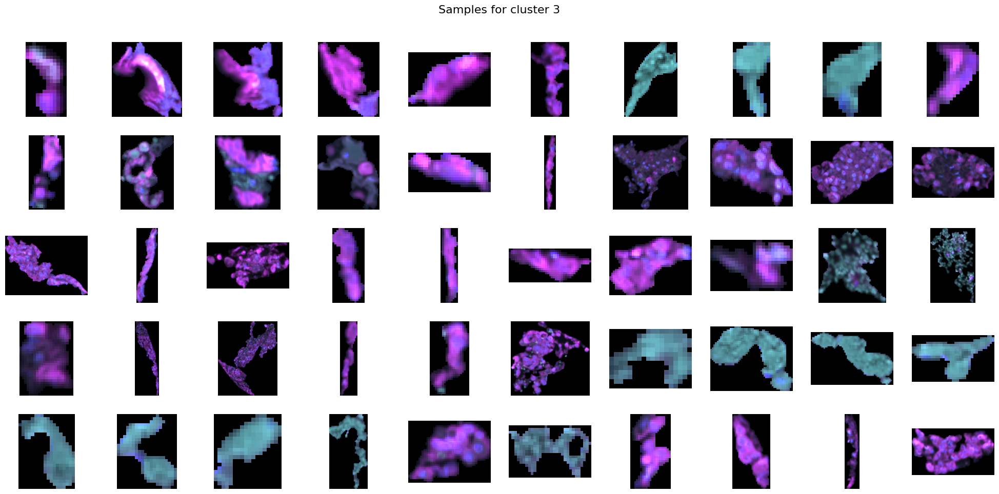

Cluster 4:


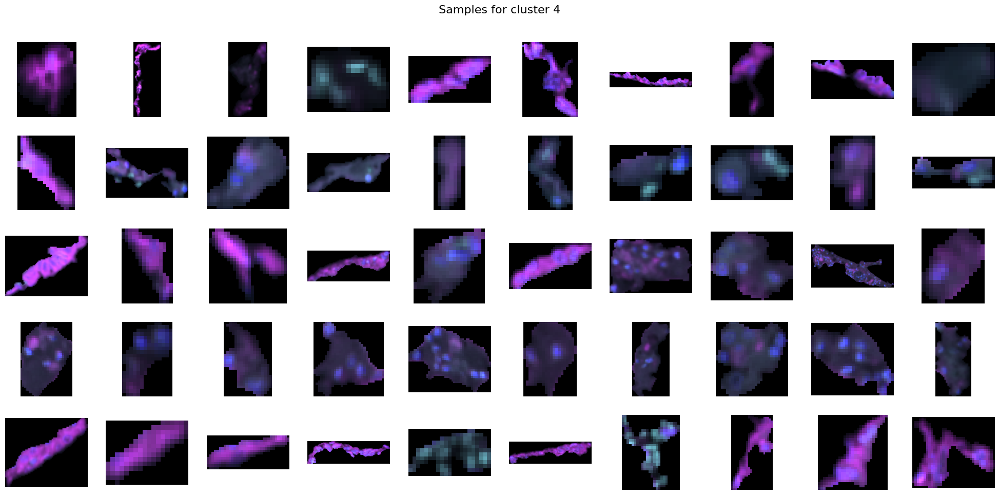

Cluster 5:


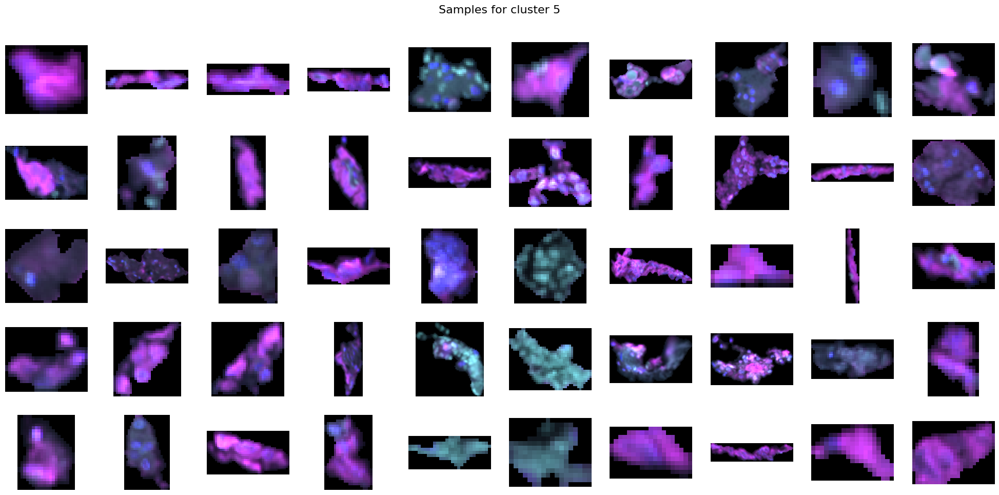

Cluster 6:


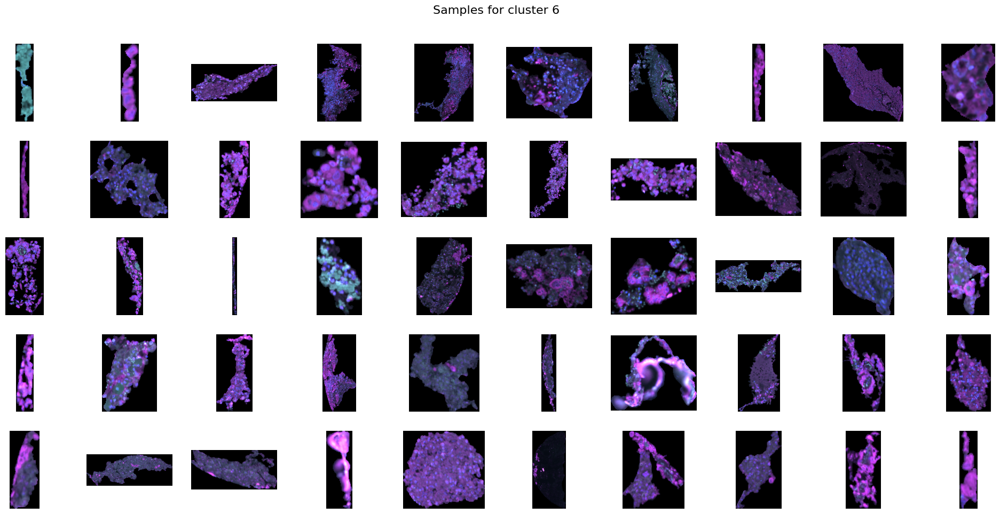

In [ ]:
print_images_for_clusters(cl_st4)

In [ ]:
https://www.researchgate.net/publication/373163948_Automated_Semiconductor_Defect_Inspection_in_Scanning_Electron_Microscope_Images_a_Systematic_Review

### 2.3 Viewing results and storing clusters

In [ ]:
cl_st4.results

{'img': array([[  0,   0,   0, ...,   0,   0, 255],
        [  0,   0,   0, ...,   0,   0, 255],
        [  0,   0,   0, ...,   0,   0, 255],
        ...,
        [  0,   0,   0, ...,   0,   0, 255],
        [  0,   0,   0, ...,   0,   0, 255],
        [  0,   0,   0, ...,   0,   0, 255]], dtype=uint8),
 'feat': array([[ 9.84027526e+02,  1.07511884e+02, -1.17143669e+03, ...,
         -2.08687807e+01,  6.26069895e+00, -6.54638682e+00],
        [-4.28470020e+02, -6.93178133e+02, -1.40760018e+03, ...,
         -1.03110589e+01, -1.75732430e+01, -2.51643174e+01],
        [-2.65388757e+03,  5.66007290e+02, -3.35715179e+02, ...,
         -5.23014216e+01, -2.48525330e+01, -1.25613096e+01],
        ...,
        [-2.75972299e+03,  1.21552862e+02, -3.25451353e+02, ...,
         -5.09013547e+01,  3.11329735e+01,  2.08282322e+01],
        [-3.10956198e+03, -5.61516426e+02,  2.65806578e+02, ...,
          2.33271696e+00, -5.06887714e+01, -2.82981621e+01],
        [-2.37872225e+03,  8.15178551e+02, -

In [ ]:
import pandas as pd
import seaborn as sns

df = pd.DataFrame({
    "label": cl_st4.results["labels"],
    "filename": cl_st4.results["filenames"],
    'X_coord': cl_st4.results['xycoord'][:, 0],
    'Y_coord': cl_st4.results['xycoord'][:, 1]
})

df

NameError: name 'cl_st4' is not defined

In [ ]:
class_counts = df.groupby('label').size()

plt.figure(figsize=(15, 8))
sns.countplot(df, x=df["label"].astype("int32"), legend="brief", palette=plt.get_cmap("tab20b").colors) #stat="percent"

NameError: name 'df' is not defined

In [ ]:
import shutil

out_path = "/content/drive/MyDrive/pathdata/clusters"
path_segments = "/content/drive/MyDrive/pathdata/segments_with_padding"


for index, entry in tqdm(df.iterrows()):

  source_path = os.path.join(path_segments, entry['filename'])

  if os.path.exists(source_path):
    cluster_path = os.path.join(out_path, f"cluster_{int(entry['label'])+1}")
    os.makedirs(cluster_path, exist_ok=True)
    shutil.copy(source_path, cluster_path)
  else:
    print(f"Source image '{entry['filename']}' not found in '{path_segments}'")

0it [00:00, ?it/s]

In [ ]:
! ls /content/drive/MyDrive/pathdata/clusters/cluster_8

'BOMI2_TIL_1_Core[1,10,A]_[5377,51061]_seg_1.png'
'BOMI2_TIL_1_Core[1,10,A]_[5377,51061]_seg_4.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_22.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_31.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_33.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_35.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_39.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_44.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_48.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_50.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_7.png'
'BOMI2_TIL_1_Core[1,10,B]_[7234,51013]_seg_9.png'
'BOMI2_TIL_1_Core[1,10,C]_[9044,50775]_seg_7.png'
'BOMI2_TIL_1_Core[1,10,C]_[9044,50775]_seg_8.png'
'BOMI2_TIL_1_Core[1,10,G]_[16330,50712]_seg_0.png'
'BOMI2_TIL_1_Core[1,10,G]_[16330,50712]_seg_12.png'
'BOMI2_TIL_1_Core[1,10,G]_[16330,50712]_seg_15.png'
'BOMI2_TIL_1_Core[1,10,G]_[16330,50712]_seg_19.png'
'BOMI2_TIL_1_Core[1,10,G]_[16330,50712]_seg_2.png'
'BOMI2_TIL_1_Core[1,10,G]_[16330,5

In [ ]:
small_segment_cluster_path = os.path.join(out_path, f"cluster_{max(df['label'])+2}")
os.makedirs(small_segment_cluster_path, exist_ok=True)

with open(excluded_paths_file, "r") as f:
    excluded_paths = [line.replace("segments", "segments_with_padding") for line in f.read().splitlines()]


for path in tqdm(excluded_paths):
  if os.path.exists(path):
    shutil.copy(path, small_segment_cluster_path)
  else:
    print(f"Path {path} DOES NOT EXIST!")

  0%|          | 0/937 [00:00<?, ?it/s]

Path /content/drive/MyDrive/pathdata/segments_with_padding/BOMI2_TIL_1_Core[1,1,A]_[5091,35249]_seg_7.png DOES NOT EXIST!


### 2.4 Applying classes (utility function)

In [ ]:
import seaborn as sns

new_clust_df = pd.DataFrame([
    {"clust_id": "0", "paths": glob("/content/drive/MyDrive/pathdata/clusters/cluster_0/*.png")},
    {"clust_id": "1", "paths": glob("/content/drive/MyDrive/pathdata/clusters/cluster_1/*.png")+glob("/content/drive/MyDrive/pathdata/clusters/cluster_2/*.png")},
    {"clust_id": "2", "paths": glob("/content/drive/MyDrive/pathdata/clusters/cluster_3/*.png")},
    {"clust_id": "3", "paths": glob("/content/drive/MyDrive/pathdata/clusters/cluster_4/*.png")+glob("/content/drive/MyDrive/pathdata/clusters/cluster_8/*.png")},
    {"clust_id": "4", "paths": glob("/content/drive/MyDrive/pathdata/clusters/cluster_5/*.png")+glob("/content/drive/MyDrive/pathdata/clusters/cluster_6/*.png")},
    {"clust_id": "5", "paths": glob("/content/drive/MyDrive/pathdata/clusters/cluster_7/*.png")}
    ])

new_clust_df_exploded = new_clust_df.explode('paths')

new_clust_df_exploded

,clust_id,paths
0,0,/content/drive/MyDrive/pathdata/clusters/clust...
0,0,/content/drive/MyDrive/pathdata/clusters/clust...
0,0,/content/drive/MyDrive/pathdata/clusters/clust...
0,0,/content/drive/MyDrive/pathdata/clusters/clust...
0,0,/content/drive/MyDrive/pathdata/clusters/clust...
...,...,...
5,5,/content/drive/MyDrive/pathdata/clusters/clust...
5,5,/content/drive/MyDrive/pathdata/clusters/clust...
5,5,/content/drive/MyDrive/pathdata/clusters/clust...
5,5,/content/drive/MyDrive/pathdata/clusters/clust...


<ipython-input-36-007aaf6e5cc2>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(new_clust_df_exploded, x=new_clust_df_exploded["clust_id"].astype("int32"), legend="brief", palette=plt.get_cmap("tab20b").colors) #stat="percent"


<Axes: xlabel='clust_id', ylabel='count'>

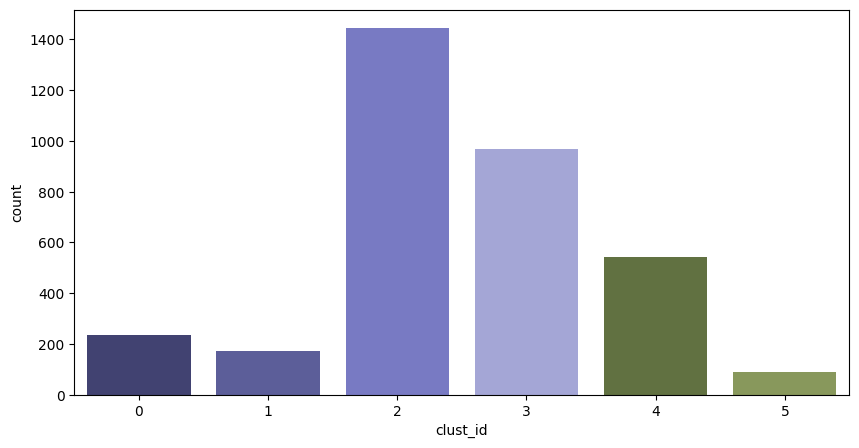

In [ ]:
class_counts = new_clust_df_exploded.groupby('clust_id').size()

plt.figure(figsize=(10, 5))
sns.countplot(new_clust_df_exploded, x=new_clust_df_exploded["clust_id"].astype("int32"), legend="brief", palette=plt.get_cmap("tab20b").colors) #stat="percent"

# 3. SEGMENTATION 💜

In [ ]:
def recursive_file_search(root_folder, substring, extension):
  found_files = []
  for root, dirs, files in os.walk(root_folder):
      for file in files:
          if file.endswith(extension) and substring in file:
              found_files.append(os.path.join(root, file))
  return found_files


def read_img_cv2(tensor):

  image = np.float32(tensor.permute(1, 2, 0).numpy())
  grayscale_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
  (thresh, binary_img) = cv2.threshold(grayscale_image, 0.01, 2, 0)

  binary_img = binary_img.astype(np.uint8)

  contours, hierarchy = cv2.findContours(binary_img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE) #error here

  image_for_plot = cv2.drawContours(image.copy(), contours, -1, (0, 255, 0), 2)

  return np.array(contours, dtype=object), image_for_plot

In [ ]:
import torchvision.transforms as transforms
import cv2
from PIL import Image

geo_folder = '/content/drive/MyDrive/pathdata/yolov8_annotations'
clusters_path = '/content/drive/MyDrive/pathdata/clusters'
segment_path = '/content/drive/MyDrive/pathdata/segments_with_padding'
labels_path = "/content/drive/MyDrive/pathdata/wsi_dataset/labels"
image_width = 3752
image_height = 2808



def sample_to_yolo_format(sample):
  '''
    TODO: Description
  '''

  # Find all segments of sample
  segment_paths = recursive_file_search(clusters_path, sample['id'], '.png')

  txt_filepath = os.path.join(labels_path, f"{sample['id']}_component_data.txt")
  segments = sample['segments']

  # Start writing to label txt file
  with open(txt_filepath, 'a+') as f:

    # Extract class and border coordinates
    for path in tqdm(segment_paths, leave=False):

      seg_index = int(str.split(path,"_seg_")[1].replace(".png",""))
      contours, img = read_img_cv2(segments[seg_index])
      cluster_id = str.split(path.replace(f"{clusters_path}/cluster_", ""), "/")[0]

      if cluster_id!="":
        formatted_contours = np.concatenate([coord for contour in contours for coord in contour]).flatten()
        normalized_contours = [round(coord / image_width , 3) if i % 2 == 0 else round(coord / image_height, 3) for i, coord in enumerate(formatted_contours)]

        f.write(" ".join(map(str, [cluster_id] + normalized_contours)) + '\n')

        print(formatted_contours)
        print(normalized_contours)
        print(f"Cluster ID: {cluster_id}")
        print("*"*20)
      else:
        print("Not assigned to cluster!!!!!!")


In [ ]:
sample=WSI(bin_map_dir, originals_dir, 31)
sample_to_yolo_format(sample)

In [ ]:
def correct_label_files(paths):
  for file_path in tqdm(paths):
    try:
      with open(file_path, 'r') as file:
        lines = file.readlines()

      corrected_lines = [line for line in lines if not line.startswith(' ')]

      if lines!=corrected_lines:
        print("Found path to be corrected: ", file_path)
        with open(file_path, 'w') as file:
          file.writelines(corrected_lines)
          print(f"Processed file: {file_path}")
      else:
        print(f"Path {file_path} looks OK")




    except Exception as e:
        print(f"Error processing file {file_path}: {e}")

In [ ]:
correct_label_files(all_label_paths)

In [ ]:
all_label_paths = recursive_file_search("/content/drive/MyDrive/pathdata/wsi_dataset/labels", "component_data", ".txt")
all_label_paths

In [ ]:
for i in trange(len(glob(originals_dir))):
  sample=WSI(bin_map_dir, originals_dir, i)
  if (len(sample['segments'])!=0):
    sample_to_yolo_format(sample)
    print(f"Saved lables of {sample['id']}")

In [ ]:
image_colored_path = '/content/drive/MyDrive/pathdata/wsi_dataset/images_colored'
image_path = '/content/drive/MyDrive/pathdata/wsi_dataset/images'

from torchvision.utils import save_image

for i in trange(len(glob(originals_dir))):
  sample=WSI(bin_map_dir, originals_dir, i)

  if (len(sample['segments'])!=0):

    images_filepath = os.path.join(image_path, f"{sample['id']}_component_data.tif")
    #save_image(sample['original'], images_filepath)
    imwrite(images_filepath, sample['original'].numpy())

    images_colored_filepath = os.path.join(image_colored_path, f"{sample['id']}_component_data.png")
    save_image(sample['original_colored'], images_colored_filepath)

    print(f"Saved original of sample {sample['id']}")


  else:
    print(f"No annotations found for {sample['id']}")



In [ ]:
import shutil

base_path = '/content/drive/MyDrive/pathdata/wsi_dataset'
labels_path = os.path.join(base_path, 'labels')
images_path = os.path.join(base_path, 'images_colored')
# train_labels_path = os.path.join(labels_path, 'train')
# test_labels_path = os.path.join(labels_path, 'test')
train_images_path = os.path.join(images_path, 'train')
test_images_path = os.path.join(images_path, 'test')

# # List all samples
# label_files = [f for f in os.listdir(labels_path) if f.endswith('.txt') and os.path.isfile(os.path.join(labels_path, f))]
# image_files = [f for f in os.listdir(images_path) if f.endswith('.tif') and os.path.isfile(os.path.join(images_path, f))]

# # Ensure we have corresponding label and image files
# sample_ids = set([os.path.splitext(f)[0] for f in label_files]).intersection(set([os.path.splitext(f)[0] for f in image_files]))

# # Randomly select 20% for the test set
# test_sample_count = int(0.2 * len(sample_ids))
# test_samples = random.sample(sample_ids, test_sample_count)

# Move files to train and test directories
for sample_id in tqdm(sample_ids, desc="Moving samples"):
    label_file = f"{sample_id}.txt"
    image_file = f"{sample_id}.png"

    if sample_id in test_samples:
        #shutil.move(os.path.join(labels_path, label_file), os.path.join(test_labels_path, label_file))
        shutil.move(os.path.join(images_path, image_file), os.path.join(test_images_path, image_file))
    else:
        #shutil.move(os.path.join(labels_path, label_file), os.path.join(train_labels_path, label_file))
        shutil.move(os.path.join(images_path, image_file), os.path.join(train_images_path, image_file))

Moving samples:   0%|          | 0/116 [00:00<?, ?it/s]

In [ ]:
print(len(glob("/content/drive/MyDrive/pathdata/wsi_dataset/images/val/*png")))
print(len(glob("/content/drive/MyDrive/pathdata/wsi_dataset/labels/val/*txt")))

23
23


## 3.1 YOLO

In [ ]:
! pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 757.2/757.2 kB 10.3 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
from ultralytics import YOLO

model = YOLO('yolov8n-seg.pt')

# Train the model
results = model.train(data='/content/drive/MyDrive/pathdata/wsi_dataset/dataset.yaml', epochs=300, imgsz=640)

Ultralytics YOLOv8.2.18 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=segment, mode=train, model=yolov8n-seg.pt, data=/content/drive/MyDrive/pathdata/wsi_dataset/dataset.yaml, epochs=300, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, sh

train: Scanning /content/drive/MyDrive/pathdata/wsi_dataset/labels/train.cache... 93 images, 0 backgrounds, 0 corrupt: 100%|██████████| 93/93 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/MyDrive/pathdata/wsi_dataset/labels/val.cache... 23 images, 0 backgrounds, 0 corrupt: 100%|██████████| 23/23 [00:00<?, ?it/s]


Plotting labels to runs/segment/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 66 weight(decay=0.0), 77 weight(decay=0.0005), 76 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train3
Starting training for 300 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/300      4.24G      2.632      4.639      4.557      1.825        535        640: 100%|██████████| 6/6 [00:06<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.44s/it]


                   all         23        736    0.00198     0.0775     0.0023   0.000916   0.000612     0.0424   0.000599   0.000243

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/300      3.48G      2.579      4.326      4.552      1.801        553        640: 100%|██████████| 6/6 [00:02<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.37it/s]

                   all         23        736    0.00278     0.0844    0.00324    0.00141   0.000662     0.0365   0.000798   0.000304



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/300      3.31G      2.397      3.869      4.349      1.613        554        640: 100%|██████████| 6/6 [00:03<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.69s/it]

                   all         23        736    0.00243     0.0953     0.0191     0.0106   0.000568     0.0347    0.00121   0.000244



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/300      3.85G      2.362      3.573       4.17       1.52        809        640: 100%|██████████| 6/6 [00:03<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.54s/it]

                   all         23        736    0.00265     0.0954     0.0223     0.0121    0.00159     0.0467    0.00367    0.00104



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/300      4.06G      2.324      3.449       3.98      1.493        431        640: 100%|██████████| 6/6 [00:04<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.71s/it]

                   all         23        736    0.00315     0.0936     0.0251     0.0133    0.00173     0.0588    0.00262   0.000814



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/300      3.62G      2.316      3.366      3.711      1.417        566        640: 100%|██████████| 6/6 [00:04<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.51s/it]

                   all         23        736    0.00366       0.13     0.0256     0.0169    0.00204      0.055     0.0114    0.00455



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/300      3.44G      2.281      3.229      3.456      1.393        612        640: 100%|██████████| 6/6 [00:08<00:00,  1.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.62s/it]

                   all         23        736    0.00732      0.176     0.0259     0.0141    0.00538     0.0776     0.0112    0.00574



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/300      3.81G      2.218      3.157      3.242      1.375        479        640: 100%|██████████| 6/6 [00:07<00:00,  1.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         23        736      0.013       0.23     0.0318     0.0138    0.00972      0.144     0.0255    0.00925



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/300       3.8G      2.249      3.113      3.107       1.39        450        640: 100%|██████████| 6/6 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.55s/it]

                   all         23        736     0.0219      0.256     0.0365     0.0181     0.0138      0.171     0.0279     0.0116



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/300      3.35G      2.239      3.078       3.01      1.369        678        640: 100%|██████████| 6/6 [00:03<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.73s/it]

                   all         23        736      0.035      0.252     0.0615     0.0335     0.0316      0.189     0.0482     0.0168



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/300      3.39G      2.231      3.048      2.914      1.368        537        640: 100%|██████████| 6/6 [00:05<00:00,  1.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.89s/it]

                   all         23        736     0.0721      0.302     0.0965     0.0474     0.0436      0.191     0.0596      0.018



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/300      3.77G      2.136       2.95      2.799      1.339        581        640: 100%|██████████| 6/6 [00:03<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.83s/it]

                   all         23        736      0.047       0.29     0.0803     0.0363     0.0471      0.242      0.067     0.0208



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/300      3.36G      2.151      2.952      2.715      1.333        673        640: 100%|██████████| 6/6 [00:04<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.66s/it]

                   all         23        736     0.0396      0.312     0.0897     0.0384     0.0348      0.229      0.062     0.0189



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/300      4.22G      2.145      2.949       2.74      1.343        467        640: 100%|██████████| 6/6 [00:04<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.98s/it]

                   all         23        736      0.378      0.122        0.1     0.0484      0.238      0.077     0.0607     0.0188



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/300       3.9G      2.092      2.822      2.609      1.326        487        640: 100%|██████████| 6/6 [00:03<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

                   all         23        736      0.391     0.0881      0.101     0.0509      0.359     0.0674     0.0923      0.024



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/300      4.05G      2.144      2.943      2.631      1.348        409        640: 100%|██████████| 6/6 [00:03<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         23        736        0.3      0.124      0.102     0.0471      0.244     0.0772     0.0607     0.0233



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/300      3.98G       2.15      2.848      2.597      1.345        573        640: 100%|██████████| 6/6 [00:03<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

                   all         23        736      0.313      0.108        0.1     0.0457      0.226     0.0761     0.0572     0.0202



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/300      3.85G      2.089      2.811      2.573      1.287        654        640: 100%|██████████| 6/6 [00:04<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.60s/it]

                   all         23        736      0.146      0.128      0.106     0.0503      0.101     0.0813     0.0564     0.0219



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/300       3.6G      2.121      2.775      2.528      1.324        770        640: 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

                   all         23        736      0.137      0.139      0.108     0.0513      0.101     0.0896     0.0663     0.0222



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/300      4.12G      2.035      2.767      2.462      1.281        539        640: 100%|██████████| 6/6 [00:04<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.56s/it]

                   all         23        736      0.139      0.164       0.11     0.0529      0.263      0.125      0.105     0.0318



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/300         4G      2.031      2.717      2.421      1.289        448        640: 100%|██████████| 6/6 [00:03<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.44s/it]


                   all         23        736      0.178      0.198      0.119     0.0625      0.152      0.197       0.11     0.0356

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/300      3.35G       2.06      2.707      2.416      1.267        544        640: 100%|██████████| 6/6 [00:03<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.50s/it]

                   all         23        736      0.177      0.174      0.112     0.0536      0.119      0.135     0.0699     0.0296



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/300       3.4G       2.03      2.685      2.383      1.267        470        640: 100%|██████████| 6/6 [00:03<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.20s/it]

                   all         23        736      0.155      0.159      0.101     0.0492      0.126      0.172     0.0787      0.029



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/300      3.99G      1.987      2.679      2.347      1.259        804        640: 100%|██████████| 6/6 [00:04<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.21s/it]

                   all         23        736      0.157      0.202      0.103     0.0427      0.131      0.197     0.0763     0.0251



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/300      4.04G      2.041      2.699      2.294      1.257        773        640: 100%|██████████| 6/6 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]

                   all         23        736      0.141      0.168     0.0886     0.0427      0.113      0.157     0.0677     0.0227



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/300      3.42G      2.008       2.66      2.361      1.267        432        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.59s/it]

                   all         23        736      0.161      0.136      0.093     0.0406      0.124      0.115     0.0738     0.0251



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/300      3.91G      1.979      2.556      2.319      1.261        545        640: 100%|██████████| 6/6 [00:04<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.50s/it]

                   all         23        736      0.323      0.112      0.102     0.0404       0.29     0.0962     0.0717     0.0244



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/300      3.96G       1.96      2.605      2.287      1.261        519        640: 100%|██████████| 6/6 [00:04<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.78s/it]

                   all         23        736       0.23      0.145      0.122     0.0555      0.187      0.089     0.0868     0.0233



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/300      3.57G       1.95        2.6      2.279      1.238        437        640: 100%|██████████| 6/6 [00:04<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         23        736      0.244      0.149      0.136     0.0611      0.155        0.1     0.0883     0.0246



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/300      3.85G      1.881      2.516      2.175      1.228        559        640: 100%|██████████| 6/6 [00:03<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         23        736       0.22      0.144      0.144      0.072      0.165      0.101     0.0765     0.0274



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/300      3.97G      1.901      2.527      2.189      1.236        501        640: 100%|██████████| 6/6 [00:03<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.64s/it]

                   all         23        736      0.205      0.183      0.116     0.0599      0.141      0.107     0.0725     0.0284



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/300       3.7G      1.901        2.5      2.174      1.219        588        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]

                   all         23        736      0.387      0.122       0.14     0.0662      0.255      0.106     0.0696     0.0277



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/300      4.14G      1.887      2.437      2.126      1.208        572        640: 100%|██████████| 6/6 [00:04<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.39s/it]

                   all         23        736      0.435       0.12      0.125     0.0516       0.28     0.0754     0.0686     0.0285



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/300      4.41G      1.868      2.495      2.133      1.203        562        640: 100%|██████████| 6/6 [00:04<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

                   all         23        736      0.502      0.127      0.118     0.0461      0.257     0.0891     0.0749     0.0311



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/300       3.7G       1.88      2.465      2.106      1.192        533        640: 100%|██████████| 6/6 [00:03<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.40s/it]

                   all         23        736      0.291      0.128      0.105     0.0438      0.368     0.0992     0.0693     0.0296



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/300      4.65G      1.828      2.408      2.073      1.207        514        640: 100%|██████████| 6/6 [00:03<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]

                   all         23        736      0.534      0.139      0.111     0.0464      0.398      0.122      0.101     0.0355



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/300      3.67G      1.821      2.364      2.039       1.21        438        640: 100%|██████████| 6/6 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]

                   all         23        736      0.439       0.14      0.115     0.0538      0.427       0.13      0.108     0.0368



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/300      3.77G      1.814      2.393      2.052      1.204        461        640: 100%|██████████| 6/6 [00:03<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.72s/it]

                   all         23        736      0.306      0.125      0.111      0.052      0.305      0.116      0.114     0.0355



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/300      4.09G      1.817      2.371      2.068      1.201        503        640: 100%|██████████| 6/6 [00:04<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.57s/it]

                   all         23        736      0.285      0.133      0.107     0.0484      0.284      0.128      0.106     0.0356



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/300      3.87G      1.762       2.37      1.952      1.176        682        640: 100%|██████████| 6/6 [00:04<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.76s/it]

                   all         23        736      0.286      0.144      0.114     0.0588        0.4       0.14      0.119     0.0398



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/300       3.8G      1.823      2.486      2.008      1.201        466        640: 100%|██████████| 6/6 [00:03<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.87s/it]

                   all         23        736      0.172      0.146      0.109     0.0536      0.174      0.139      0.101     0.0388



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/300      4.29G      1.827      2.447      1.977      1.181        602        640: 100%|██████████| 6/6 [00:03<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]

                   all         23        736      0.444      0.139      0.124     0.0585      0.426      0.135      0.103     0.0401



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/300      3.72G      1.772      2.275      1.903      1.154        498        640: 100%|██████████| 6/6 [00:03<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.89s/it]

                   all         23        736       0.42      0.153      0.138     0.0651      0.451      0.124      0.111     0.0463



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/300       3.7G      1.749      2.305      1.893      1.141        508        640: 100%|██████████| 6/6 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.50s/it]

                   all         23        736      0.527      0.153      0.171     0.0888      0.403      0.125      0.139     0.0556



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/300      3.97G      1.756      2.283      1.942      1.174        523        640: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]

                   all         23        736      0.501      0.168       0.18     0.0906      0.408      0.121      0.139     0.0554



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/300      3.54G      1.774      2.356      1.887      1.172        562        640: 100%|██████████| 6/6 [00:04<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         23        736        0.3      0.174      0.165     0.0677      0.195      0.131      0.116     0.0428



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/300      4.08G      1.792      2.376      1.902      1.155        523        640: 100%|██████████| 6/6 [00:04<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         23        736      0.328      0.158      0.154     0.0637        0.2      0.112      0.104     0.0379



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/300      3.48G       1.76      2.327      1.936      1.159        481        640: 100%|██████████| 6/6 [00:03<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]

                   all         23        736      0.239      0.184      0.141     0.0552       0.14      0.116     0.0949     0.0299



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/300      3.92G      1.738      2.301      1.877      1.162        482        640: 100%|██████████| 6/6 [00:03<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]

                   all         23        736      0.154      0.162      0.114     0.0524      0.274       0.13      0.102     0.0331



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/300      3.44G      1.765      2.299      1.903      1.171        527        640: 100%|██████████| 6/6 [00:04<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.27s/it]

                   all         23        736      0.223      0.173      0.148     0.0647      0.159      0.116      0.108     0.0376



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/300      4.17G      1.713       2.26      1.863      1.144        540        640: 100%|██████████| 6/6 [00:04<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.27s/it]

                   all         23        736      0.389      0.136      0.143     0.0636      0.169      0.125      0.113     0.0405



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/300      3.84G       1.72      2.214      1.886      1.144        358        640: 100%|██████████| 6/6 [00:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

                   all         23        736      0.289      0.192       0.17     0.0789      0.216      0.172      0.128      0.048



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/300      3.82G      1.743      2.332      1.872      1.149        620        640: 100%|██████████| 6/6 [00:03<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.58s/it]

                   all         23        736      0.342      0.177      0.191     0.0936      0.239      0.173      0.142     0.0536



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/300       3.6G      1.735      2.211      1.842      1.136        449        640: 100%|██████████| 6/6 [00:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.66s/it]

                   all         23        736      0.316      0.195      0.168     0.0731      0.191      0.142      0.111     0.0405



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/300      4.22G      1.726      2.214      1.854      1.141        436        640: 100%|██████████| 6/6 [00:03<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.57s/it]

                   all         23        736      0.374      0.197       0.17     0.0797      0.402      0.128      0.103     0.0414



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/300      4.21G      1.721      2.274      1.801      1.144        628        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

                   all         23        736      0.339      0.177      0.165     0.0794      0.251      0.151      0.133     0.0507



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/300      3.57G      1.609       2.16      1.748      1.113        531        640: 100%|██████████| 6/6 [00:03<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

                   all         23        736      0.336      0.175      0.161     0.0799      0.263      0.152      0.135     0.0557



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/300      3.91G      1.656       2.18      1.752      1.124        736        640: 100%|██████████| 6/6 [00:03<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.44s/it]

                   all         23        736      0.366      0.196      0.171     0.0894      0.334      0.193       0.15     0.0574



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/300      3.99G      1.722      2.221      1.786      1.125        552        640: 100%|██████████| 6/6 [00:04<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.44s/it]

                   all         23        736      0.393      0.183      0.172     0.0887      0.316      0.179      0.152     0.0568



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/300      3.71G       1.67      2.195      1.738       1.13        426        640: 100%|██████████| 6/6 [00:04<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         23        736      0.345      0.176      0.172     0.0749       0.38       0.15      0.136     0.0532



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     61/300      4.03G      1.627      2.185      1.703      1.116        465        640: 100%|██████████| 6/6 [00:03<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.65s/it]


                   all         23        736      0.362      0.174      0.172     0.0797      0.398       0.17      0.141     0.0511

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     62/300      3.96G      1.647       2.15      1.684      1.115        578        640: 100%|██████████| 6/6 [00:03<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.82s/it]

                   all         23        736      0.395      0.166      0.196      0.106      0.361      0.152      0.186      0.056



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     63/300      3.92G      1.675      2.256      1.706      1.117        511        640: 100%|██████████| 6/6 [00:03<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.56s/it]

                   all         23        736      0.411      0.149      0.177     0.0962      0.361      0.137      0.166     0.0504



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     64/300      3.85G      1.651       2.21      1.692       1.11        558        640: 100%|██████████| 6/6 [00:04<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]

                   all         23        736      0.392      0.159      0.137     0.0683      0.342      0.145      0.127     0.0476



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     65/300      3.49G      1.696      2.189      1.692      1.109        511        640: 100%|██████████| 6/6 [00:03<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.47s/it]

                   all         23        736      0.398      0.152      0.141     0.0693      0.377      0.144      0.129     0.0482



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     66/300      3.98G       1.62      2.194      1.674      1.089        478        640: 100%|██████████| 6/6 [00:03<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         23        736      0.385      0.152      0.162      0.078      0.372      0.147       0.12     0.0434



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     67/300      3.79G       1.65      2.178      1.688      1.109        640        640: 100%|██████████| 6/6 [00:03<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.74s/it]

                   all         23        736      0.342      0.178      0.161     0.0815      0.267      0.146      0.125     0.0458



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     68/300       3.7G      1.627      2.126      1.706      1.111        604        640: 100%|██████████| 6/6 [00:03<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.01s/it]

                   all         23        736      0.284      0.189      0.164     0.0862      0.262       0.14      0.123     0.0502



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     69/300      4.04G      1.659       2.24      1.634      1.099        562        640: 100%|██████████| 6/6 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.95s/it]

                   all         23        736      0.292      0.169      0.139     0.0767      0.384      0.142      0.124     0.0484



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     70/300      3.66G      1.558      2.117      1.594      1.081        450        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.84s/it]

                   all         23        736      0.298      0.176      0.135     0.0666      0.306      0.125      0.111     0.0436



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     71/300       3.6G      1.594      2.099      1.617      1.082        558        640: 100%|██████████| 6/6 [00:03<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.73s/it]

                   all         23        736      0.335      0.143       0.14     0.0669      0.297      0.128      0.107     0.0467



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     72/300      3.79G       1.61      2.176      1.587      1.074        598        640: 100%|██████████| 6/6 [00:03<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.62s/it]

                   all         23        736      0.429      0.137      0.143     0.0743      0.357      0.165      0.128     0.0545



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     73/300      3.84G      1.585      2.152      1.602      1.081        475        640: 100%|██████████| 6/6 [00:03<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]

                   all         23        736      0.437      0.131      0.135     0.0737      0.348      0.164      0.129     0.0562



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     74/300      3.79G      1.574       2.06      1.584      1.075        585        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]

                   all         23        736      0.419      0.131      0.139     0.0711      0.377      0.157      0.104     0.0434



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     75/300      4.07G      1.587       2.07      1.599      1.074        618        640: 100%|██████████| 6/6 [00:03<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

                   all         23        736      0.372      0.179      0.158     0.0847      0.402      0.149      0.124     0.0548



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     76/300      3.96G       1.58      2.071      1.531      1.082        612        640: 100%|██████████| 6/6 [00:03<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

                   all         23        736      0.371      0.161      0.192     0.0927       0.39      0.137      0.138     0.0543



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     77/300      3.65G      1.587      2.076      1.588       1.08        692        640: 100%|██████████| 6/6 [00:04<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         23        736      0.374      0.187      0.182     0.0893       0.29      0.132      0.134     0.0552



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     78/300      4.05G      1.602      2.071      1.518       1.08        630        640: 100%|██████████| 6/6 [00:03<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.50s/it]

                   all         23        736      0.284      0.181      0.173     0.0882      0.281      0.142      0.146     0.0616



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     79/300      4.08G      1.585      2.074      1.567      1.087        607        640: 100%|██████████| 6/6 [00:03<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]

                   all         23        736      0.317       0.18      0.158     0.0865      0.276      0.137      0.142     0.0619



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     80/300       3.9G      1.602      2.061      1.498      1.064        615        640: 100%|██████████| 6/6 [00:03<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         23        736      0.331       0.19      0.169      0.082      0.245      0.173      0.143     0.0562



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     81/300       4.1G      1.546      2.045      1.517      1.072        449        640: 100%|██████████| 6/6 [00:03<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]

                   all         23        736      0.387      0.158       0.15     0.0688      0.177      0.159      0.123     0.0455



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     82/300       3.8G      1.551      2.077      1.533      1.049        537        640: 100%|██████████| 6/6 [00:03<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.63s/it]

                   all         23        736      0.331      0.193      0.161     0.0796      0.325      0.192      0.155     0.0468



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     83/300      3.45G      1.501      1.999      1.474      1.054        536        640: 100%|██████████| 6/6 [00:03<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.67s/it]

                   all         23        736      0.353      0.198      0.154     0.0682       0.35      0.196      0.151     0.0452



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     84/300      4.23G      1.546      2.008      1.496      1.071        478        640: 100%|██████████| 6/6 [00:03<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.70s/it]

                   all         23        736      0.351       0.19       0.15     0.0678      0.339      0.185      0.145     0.0456



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     85/300      3.33G      1.514      2.076       1.46      1.054        528        640: 100%|██████████| 6/6 [00:03<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]

                   all         23        736      0.394      0.155      0.175      0.089      0.378      0.145      0.172     0.0534



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     86/300       3.7G      1.524      2.032      1.484      1.054        548        640: 100%|██████████| 6/6 [00:03<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.50s/it]

                   all         23        736      0.292      0.205      0.164     0.0837      0.281      0.209      0.163     0.0506



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     87/300      4.12G      1.504      2.027       1.51      1.061        522        640: 100%|██████████| 6/6 [00:04<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.70s/it]

                   all         23        736      0.347      0.165      0.163     0.0874      0.222      0.156      0.128     0.0495



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     88/300      3.76G      1.563      2.057      1.507      1.056        486        640: 100%|██████████| 6/6 [00:03<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.44s/it]

                   all         23        736      0.209      0.199      0.164     0.0847      0.161      0.165      0.126     0.0442



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     89/300       3.9G      1.506      2.083      1.466      1.048        643        640: 100%|██████████| 6/6 [00:03<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


                   all         23        736      0.215      0.161       0.16     0.0808      0.147      0.159      0.117     0.0412

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     90/300      3.82G      1.541      2.096      1.445      1.052        581        640: 100%|██████████| 6/6 [00:04<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         23        736      0.299      0.157      0.138     0.0717      0.181      0.161       0.12     0.0445



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     91/300       3.8G      1.473      1.937      1.436      1.039        458        640: 100%|██████████| 6/6 [00:03<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]

                   all         23        736      0.186      0.205      0.136     0.0722      0.159      0.174      0.114     0.0438



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     92/300      3.95G      1.494      1.935      1.448      1.054        497        640: 100%|██████████| 6/6 [00:03<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]

                   all         23        736      0.297      0.178      0.149      0.079      0.272      0.151      0.125      0.053



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     93/300      3.79G      1.549      2.096      1.474      1.047        601        640: 100%|██████████| 6/6 [00:03<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

                   all         23        736      0.452      0.184      0.156     0.0823      0.414      0.169      0.141     0.0599



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     94/300      3.49G        1.4      1.892      1.388      1.028        425        640: 100%|██████████| 6/6 [00:03<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.55s/it]

                   all         23        736      0.358      0.187      0.153     0.0791      0.345      0.182      0.131     0.0561



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     95/300      3.67G      1.472      1.941      1.416      1.035        620        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]

                   all         23        736      0.375      0.167      0.153     0.0806      0.352      0.159      0.129     0.0532



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     96/300      4.11G      1.478      1.973      1.402      1.046        420        640: 100%|██████████| 6/6 [00:03<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]

                   all         23        736      0.351      0.187      0.157     0.0807       0.31      0.172      0.131     0.0506



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     97/300       3.9G      1.514      2.008      1.445      1.059        463        640: 100%|██████████| 6/6 [00:03<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.21s/it]

                   all         23        736      0.318       0.22      0.154     0.0806      0.315      0.203      0.126     0.0498



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     98/300       3.8G      1.508       1.97      1.435       1.06        533        640: 100%|██████████| 6/6 [00:03<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.33s/it]

                   all         23        736      0.363      0.162      0.186     0.0837      0.336       0.17       0.14     0.0509



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     99/300      4.08G      1.485      1.974       1.41       1.04        661        640: 100%|██████████| 6/6 [00:03<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]

                   all         23        736      0.455      0.132      0.162     0.0781      0.327      0.166      0.143     0.0536



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    100/300      3.39G      1.499      2.032      1.392      1.034        632        640: 100%|██████████| 6/6 [00:04<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.03it/s]

                   all         23        736       0.32      0.163      0.129     0.0711      0.299      0.166       0.14     0.0535



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    101/300      3.75G      1.411      1.921       1.37      1.045        519        640: 100%|██████████| 6/6 [00:04<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         23        736      0.336      0.163      0.131     0.0742      0.359       0.17      0.148     0.0535



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    102/300      3.91G      1.482       1.93      1.398      1.042        344        640: 100%|██████████| 6/6 [00:04<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]

                   all         23        736      0.391      0.174      0.155     0.0784      0.353      0.159      0.135     0.0477



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    103/300      4.57G      1.479      1.947      1.369      1.028        597        640: 100%|██████████| 6/6 [00:04<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.10it/s]

                   all         23        736       0.41      0.173      0.158     0.0818      0.323      0.154       0.12     0.0439



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    104/300       4.1G      1.465      1.898      1.364      1.029        581        640: 100%|██████████| 6/6 [00:03<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.52s/it]

                   all         23        736      0.255      0.229      0.163     0.0813       0.15      0.167      0.111     0.0385



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    105/300      3.34G      1.427      1.957      1.339      1.028        703        640: 100%|██████████| 6/6 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.75s/it]

                   all         23        736      0.314      0.244       0.18     0.0865      0.326      0.183      0.116     0.0372



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    106/300         4G      1.466      1.956      1.344      1.026        574        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.60s/it]

                   all         23        736      0.312      0.227      0.178     0.0822      0.248      0.175       0.13     0.0459



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    107/300      3.68G      1.416      1.902      1.315      1.016        493        640: 100%|██████████| 6/6 [00:03<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]


                   all         23        736      0.356      0.246      0.195     0.0919      0.283       0.18      0.144     0.0569

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    108/300      3.91G      1.442      1.858      1.337      1.018        654        640: 100%|██████████| 6/6 [00:04<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]

                   all         23        736      0.396       0.21        0.2        0.1      0.271      0.217      0.163     0.0642



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    109/300      3.98G      1.416       1.94      1.329      1.018        668        640: 100%|██████████| 6/6 [00:04<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

                   all         23        736      0.501      0.182      0.208      0.103      0.285      0.187      0.167     0.0689



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    110/300      4.25G      1.468      1.985      1.372      1.039        588        640: 100%|██████████| 6/6 [00:03<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.44s/it]

                   all         23        736      0.273      0.193      0.185     0.0871      0.211      0.171      0.144      0.061



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    111/300      3.82G      1.402      1.916       1.31      1.016        538        640: 100%|██████████| 6/6 [00:03<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

                   all         23        736      0.358      0.179      0.181     0.0902      0.243      0.166      0.145     0.0593



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    112/300      3.89G      1.381      1.892      1.286     0.9921        648        640: 100%|██████████| 6/6 [00:03<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.27s/it]

                   all         23        736       0.35      0.203      0.182     0.0846      0.246      0.166       0.13     0.0555



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    113/300      3.86G      1.441        1.9      1.346       1.03        505        640: 100%|██████████| 6/6 [00:03<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]

                   all         23        736       0.39      0.187       0.17     0.0782      0.283      0.151      0.134     0.0553



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    114/300      3.43G      1.432      1.911      1.304      1.009        476        640: 100%|██████████| 6/6 [00:04<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

                   all         23        736       0.26      0.209      0.162      0.074      0.358      0.137      0.128     0.0531



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    115/300      4.14G      1.426      1.875      1.297      1.015        505        640: 100%|██████████| 6/6 [00:03<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.74s/it]

                   all         23        736       0.31      0.192      0.163     0.0717      0.334       0.14      0.127      0.051



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    116/300      3.97G      1.404      1.867      1.289      1.005        463        640: 100%|██████████| 6/6 [00:03<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.40s/it]

                   all         23        736      0.411       0.15      0.155     0.0778      0.402      0.144      0.138     0.0542



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    117/300      3.72G      1.381      1.962      1.305      1.009        474        640: 100%|██████████| 6/6 [00:03<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.78s/it]

                   all         23        736      0.408       0.15      0.166     0.0826      0.403      0.145      0.145      0.059



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    118/300      3.67G      1.404      1.919      1.273          1        559        640: 100%|██████████| 6/6 [00:03<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


                   all         23        736      0.356      0.165      0.152     0.0828      0.342       0.17      0.145     0.0599

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    119/300      4.01G      1.398      1.915      1.266      1.008        528        640: 100%|██████████| 6/6 [00:04<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]

                   all         23        736      0.371      0.169      0.156     0.0831      0.369      0.149      0.143     0.0601



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    120/300      3.88G      1.416      1.894      1.301      1.011        671        640: 100%|██████████| 6/6 [00:03<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         23        736      0.227      0.202      0.157     0.0838      0.205      0.189      0.138     0.0549



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    121/300      3.33G      1.365      1.859      1.249      1.015        506        640: 100%|██████████| 6/6 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         23        736      0.344      0.192      0.161      0.086      0.321      0.185      0.131     0.0494



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    122/300      4.23G      1.359      1.923      1.264      1.006        373        640: 100%|██████████| 6/6 [00:03<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         23        736       0.42       0.18      0.162     0.0806      0.379      0.173      0.149     0.0575



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    123/300      4.05G      1.397      1.879      1.262     0.9995        485        640: 100%|██████████| 6/6 [00:03<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.46s/it]

                   all         23        736      0.394      0.175      0.164     0.0821      0.412      0.164      0.161     0.0631



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    124/300      3.81G      1.374      1.915      1.246      1.002        497        640: 100%|██████████| 6/6 [00:03<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]

                   all         23        736      0.322      0.203      0.186     0.0998      0.308      0.199      0.174     0.0689



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    125/300      3.48G      1.392      1.885      1.272      1.006        482        640: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.73s/it]

                   all         23        736      0.493      0.147      0.191     0.0992      0.295      0.209      0.173     0.0701



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    126/300      4.27G      1.398      1.898      1.224      1.006        437        640: 100%|██████████| 6/6 [00:04<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.09s/it]

                   all         23        736      0.384      0.181      0.173     0.0899      0.331      0.187      0.152      0.062



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    127/300       3.4G       1.37      1.908      1.236      1.002        491        640: 100%|██████████| 6/6 [00:04<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.48s/it]

                   all         23        736      0.411      0.179      0.173     0.0863      0.361      0.158      0.145     0.0614



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    128/300      3.66G      1.381      1.837      1.233     0.9931        593        640: 100%|██████████| 6/6 [00:03<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]

                   all         23        736      0.316       0.22      0.181     0.0868      0.328      0.158      0.135     0.0571



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    129/300      3.42G       1.36      1.865      1.214     0.9979        448        640: 100%|██████████| 6/6 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         23        736       0.29      0.203      0.173     0.0826      0.323      0.165      0.132     0.0567



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    130/300      3.45G      1.363      1.863      1.214     0.9903        477        640: 100%|██████████| 6/6 [00:04<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


                   all         23        736      0.295      0.208      0.171     0.0829      0.311      0.168      0.128     0.0536

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    131/300      4.14G      1.359      1.848      1.215     0.9907        642        640: 100%|██████████| 6/6 [00:04<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.45s/it]


                   all         23        736      0.351      0.172      0.154      0.082      0.339      0.165      0.134     0.0532

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    132/300      3.76G      1.345       1.86      1.207     0.9976        449        640: 100%|██████████| 6/6 [00:04<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         23        736      0.386      0.166      0.163     0.0894      0.457      0.135      0.143     0.0572



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    133/300      3.95G      1.389      1.897      1.225     0.9928        630        640: 100%|██████████| 6/6 [00:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


                   all         23        736      0.455      0.148      0.162     0.0885      0.433       0.14       0.14     0.0568

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    134/300      3.86G      1.337      1.817      1.178     0.9816        673        640: 100%|██████████| 6/6 [00:03<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

                   all         23        736      0.383      0.165      0.146     0.0814      0.397      0.159       0.14     0.0539



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    135/300      3.62G      1.338      1.822      1.189     0.9915        538        640: 100%|██████████| 6/6 [00:03<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]

                   all         23        736      0.398      0.159      0.136     0.0738      0.381      0.151      0.133     0.0532



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    136/300      3.72G      1.346      1.866      1.203     0.9934        497        640: 100%|██████████| 6/6 [00:04<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.45s/it]

                   all         23        736      0.284      0.153      0.135     0.0724      0.239      0.146      0.129     0.0513



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    137/300      3.36G      1.409      1.899       1.23     0.9934        635        640: 100%|██████████| 6/6 [00:02<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         23        736      0.264      0.171      0.135     0.0705      0.229      0.154      0.126     0.0485



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    138/300      3.46G       1.32      1.814        1.2     0.9876        521        640: 100%|██████████| 6/6 [00:04<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.46s/it]

                   all         23        736      0.288      0.157      0.138     0.0674      0.274      0.146      0.124     0.0466



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    139/300      3.49G      1.355      1.882      1.232      0.987        675        640: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]

                   all         23        736      0.269      0.161      0.135     0.0685      0.252      0.153      0.126     0.0475



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    140/300      4.23G      1.341      1.903      1.167     0.9747        608        640: 100%|██████████| 6/6 [00:03<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.31s/it]

                   all         23        736      0.273      0.161      0.133     0.0742      0.259      0.163       0.13       0.05



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    141/300      3.81G      1.341      1.879      1.208     0.9915        395        640: 100%|██████████| 6/6 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         23        736      0.275      0.158      0.137     0.0773       0.26      0.152      0.136     0.0491



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    142/300      3.79G      1.317      1.809       1.17     0.9752        577        640: 100%|██████████| 6/6 [00:04<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.21s/it]

                   all         23        736      0.407      0.158      0.142     0.0758      0.394      0.152      0.134     0.0516



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    143/300      3.91G      1.326      1.847      1.133     0.9802        640        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.51s/it]

                   all         23        736      0.428      0.163      0.149      0.077      0.418      0.156      0.141     0.0558



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    144/300      3.76G      1.376      1.881      1.174     0.9891        431        640: 100%|██████████| 6/6 [00:03<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         23        736      0.427      0.183      0.182      0.088      0.383      0.166      0.136     0.0573



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    145/300      4.09G      1.353      1.867      1.133     0.9743        658        640: 100%|██████████| 6/6 [00:03<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.42s/it]

                   all         23        736      0.335      0.226      0.186     0.0835      0.389      0.166      0.136     0.0577



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    146/300      3.64G      1.362      1.814      1.193     0.9872        626        640: 100%|██████████| 6/6 [00:03<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.44s/it]

                   all         23        736      0.337      0.203       0.18     0.0857      0.224      0.199      0.146     0.0556



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    147/300      3.47G      1.317      1.874       1.12     0.9673        475        640: 100%|██████████| 6/6 [00:03<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         23        736      0.335      0.197      0.182     0.0843      0.224      0.191      0.146     0.0571



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    148/300      3.68G       1.33      1.823      1.133     0.9643        569        640: 100%|██████████| 6/6 [00:03<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]

                   all         23        736      0.303      0.209      0.179      0.082      0.231      0.192      0.137     0.0593



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    149/300      3.78G      1.294      1.847       1.14     0.9733        491        640: 100%|██████████| 6/6 [00:03<00:00,  1.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         23        736      0.341        0.2      0.173     0.0796      0.228      0.167      0.135     0.0552



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    150/300      3.93G      1.352      1.848      1.163     0.9748        485        640: 100%|██████████| 6/6 [00:03<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


                   all         23        736      0.353      0.181      0.171     0.0785      0.351      0.138      0.122     0.0519

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    151/300       3.8G      1.307        1.8      1.139     0.9804        440        640: 100%|██████████| 6/6 [00:03<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         23        736      0.418      0.142      0.148     0.0732      0.369      0.124      0.132     0.0538



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    152/300      3.75G      1.287      1.785      1.111      0.969        483        640: 100%|██████████| 6/6 [00:04<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]

                   all         23        736      0.414      0.149      0.149     0.0767      0.379      0.139       0.13     0.0542



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    153/300      3.33G      1.278      1.779      1.112     0.9714        440        640: 100%|██████████| 6/6 [00:03<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.18it/s]

                   all         23        736      0.465      0.151       0.15     0.0786      0.414      0.138      0.131     0.0552



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    154/300      3.67G      1.303      1.789      1.121     0.9771        623        640: 100%|██████████| 6/6 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         23        736      0.468      0.168      0.136      0.071      0.421      0.156      0.128     0.0552



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    155/300      3.43G      1.279      1.807      1.124     0.9783        586        640: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.58s/it]


                   all         23        736      0.421      0.166      0.134     0.0713       0.39       0.17      0.136     0.0555

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    156/300      3.89G      1.289      1.777      1.122     0.9828        617        640: 100%|██████████| 6/6 [00:03<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]

                   all         23        736      0.421      0.152      0.134     0.0701       0.41      0.149      0.135     0.0532



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    157/300      3.94G      1.247      1.798      1.063     0.9677        685        640: 100%|██████████| 6/6 [00:03<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.47s/it]

                   all         23        736      0.486      0.151       0.14     0.0709      0.452       0.15      0.143     0.0559



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    158/300      3.87G      1.273       1.76      1.095     0.9723        427        640: 100%|██████████| 6/6 [00:04<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.14s/it]

                   all         23        736      0.406      0.166      0.138     0.0728      0.381      0.158      0.134     0.0565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    159/300      3.36G      1.269      1.786      1.104     0.9572        489        640: 100%|██████████| 6/6 [00:04<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]

                   all         23        736      0.386      0.161      0.135     0.0728       0.38      0.157       0.13     0.0562



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    160/300      3.41G      1.287      1.758      1.115     0.9646        410        640: 100%|██████████| 6/6 [00:03<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

                   all         23        736      0.373      0.153      0.139     0.0771      0.376      0.144      0.128     0.0548



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    161/300      4.03G       1.26       1.72        1.1     0.9574        683        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


                   all         23        736      0.429      0.137       0.15     0.0837      0.371      0.159      0.137     0.0575

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    162/300      3.79G      1.265        1.8      1.097     0.9575        487        640: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]

                   all         23        736      0.399      0.169      0.156     0.0815      0.394       0.17       0.14     0.0562



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    163/300      3.35G      1.261      1.821      1.102      0.962        409        640: 100%|██████████| 6/6 [00:03<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.40s/it]

                   all         23        736      0.384      0.176      0.164     0.0846      0.379       0.18      0.148     0.0577



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    164/300      3.82G       1.29      1.742      1.098       0.97        461        640: 100%|██████████| 6/6 [00:03<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


                   all         23        736      0.377      0.175      0.187      0.093      0.348      0.171      0.152     0.0578

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    165/300      3.84G      1.278      1.777      1.096     0.9696        610        640: 100%|██████████| 6/6 [00:03<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]

                   all         23        736      0.407      0.163       0.19     0.0932      0.334       0.18      0.151     0.0583



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    166/300       3.8G      1.242      1.771       1.07     0.9534        598        640: 100%|██████████| 6/6 [00:03<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.45s/it]

                   all         23        736      0.436      0.172      0.169     0.0853      0.367      0.153      0.129     0.0544



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    167/300      3.81G      1.264       1.77      1.055     0.9514        729        640: 100%|██████████| 6/6 [00:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

                   all         23        736      0.407      0.185      0.175     0.0837      0.366      0.165      0.126     0.0523



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    168/300      3.44G      1.313      1.823      1.102     0.9598        659        640: 100%|██████████| 6/6 [00:04<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.80s/it]

                   all         23        736       0.36      0.189      0.141     0.0731      0.307      0.175      0.121     0.0503



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    169/300      3.71G      1.305      1.826      1.137     0.9668        406        640: 100%|██████████| 6/6 [00:03<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]

                   all         23        736      0.326      0.207      0.168      0.082      0.292      0.183      0.123     0.0548



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    170/300      3.55G      1.249      1.755      1.119     0.9755        350        640: 100%|██████████| 6/6 [00:03<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]

                   all         23        736      0.375      0.205      0.176     0.0819      0.338      0.196      0.148       0.06



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    171/300      4.09G      1.243      1.748      1.077     0.9502        625        640: 100%|██████████| 6/6 [00:04<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]

                   all         23        736      0.404      0.176      0.179     0.0851      0.309      0.199      0.165     0.0626



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    172/300      4.08G      1.252      1.754      1.076     0.9658        689        640: 100%|██████████| 6/6 [00:04<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.14s/it]

                   all         23        736      0.326       0.21      0.177     0.0895      0.305      0.189      0.166     0.0622



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    173/300      3.57G      1.244      1.743      1.082     0.9652        677        640: 100%|██████████| 6/6 [00:03<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]

                   all         23        736       0.33      0.184       0.16     0.0804      0.317      0.193      0.138     0.0577



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    174/300       3.3G      1.256      1.775      1.038     0.9474        670        640: 100%|██████████| 6/6 [00:04<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]

                   all         23        736      0.355      0.186      0.178      0.085      0.316      0.178      0.131     0.0565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    175/300      3.55G      1.223      1.736       1.03     0.9473        480        640: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.46s/it]

                   all         23        736      0.367      0.193      0.175     0.0827      0.334      0.182      0.128     0.0554



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    176/300      3.64G      1.289      1.733      1.095     0.9646        395        640: 100%|██████████| 6/6 [00:03<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.55s/it]


                   all         23        736      0.402      0.176      0.156     0.0785      0.373      0.167      0.121     0.0518

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    177/300      4.34G      1.251      1.725      1.028     0.9471        508        640: 100%|██████████| 6/6 [00:04<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]

                   all         23        736      0.386      0.169      0.166     0.0805      0.374      0.179      0.136     0.0552



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    178/300      3.41G      1.206       1.72      1.043     0.9561        468        640: 100%|██████████| 6/6 [00:03<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         23        736      0.381      0.176      0.152      0.076      0.348      0.173       0.13     0.0579



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    179/300      4.11G      1.317      1.764      1.071     0.9724        374        640: 100%|██████████| 6/6 [00:03<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.61s/it]

                   all         23        736      0.373      0.174      0.152     0.0757      0.341      0.165      0.129     0.0584



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    180/300      4.02G      1.276      1.723      1.031     0.9545        632        640: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

                   all         23        736      0.356      0.175      0.155     0.0789      0.324      0.171      0.134     0.0612



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    181/300      3.77G      1.202      1.711      1.016     0.9488        450        640: 100%|██████████| 6/6 [00:03<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         23        736      0.416      0.158      0.154     0.0817      0.325      0.185       0.14     0.0605



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    182/300      3.98G      1.263      1.772      1.057      0.956        607        640: 100%|██████████| 6/6 [00:04<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]

                   all         23        736       0.48      0.149      0.156     0.0879      0.406      0.143      0.139      0.064



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    183/300      3.61G      1.223      1.767       1.04     0.9481        534        640: 100%|██████████| 6/6 [00:04<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.38it/s]

                   all         23        736      0.499      0.149      0.154     0.0851       0.46      0.139      0.139     0.0616



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    184/300      3.79G      1.267      1.765      1.061      0.948        656        640: 100%|██████████| 6/6 [00:03<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]

                   all         23        736      0.534      0.148      0.157     0.0877      0.447      0.142      0.143     0.0629



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    185/300       3.7G      1.266      1.778      1.077     0.9664        601        640: 100%|██████████| 6/6 [00:03<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.16it/s]

                   all         23        736      0.507      0.154      0.162     0.0928      0.479      0.151      0.151     0.0631



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    186/300      3.33G      1.245       1.76      1.056     0.9513        529        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         23        736      0.348      0.167      0.172     0.0975      0.315       0.16      0.158     0.0661



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    187/300      3.67G      1.201      1.708      1.034     0.9501        685        640: 100%|██████████| 6/6 [00:04<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         23        736      0.273      0.186      0.175      0.101      0.252      0.178      0.155     0.0643



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    188/300      3.78G      1.256      1.756      1.064     0.9536        539        640: 100%|██████████| 6/6 [00:04<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.39s/it]

                   all         23        736       0.25      0.192      0.154      0.089      0.211      0.177       0.14     0.0524



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    189/300      3.94G      1.284        1.8      1.053     0.9513        496        640: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         23        736      0.235      0.198      0.151     0.0846      0.202      0.185      0.135     0.0473



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    190/300      4.31G      1.185      1.721     0.9857     0.9337        566        640: 100%|██████████| 6/6 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.21s/it]

                   all         23        736      0.218      0.204      0.148     0.0821      0.191      0.186      0.136     0.0522



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    191/300      4.07G      1.249      1.713      1.016     0.9466        607        640: 100%|██████████| 6/6 [00:03<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         23        736      0.276      0.181      0.152     0.0838      0.251      0.164      0.137     0.0554



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    192/300      4.31G      1.295      1.816      1.043      0.948        823        640: 100%|██████████| 6/6 [00:03<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.43s/it]

                   all         23        736      0.285      0.172      0.146     0.0834      0.249      0.159       0.13     0.0524



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    193/300      4.28G      1.202      1.707      1.008     0.9389        421        640: 100%|██████████| 6/6 [00:04<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]

                   all         23        736      0.402      0.172      0.143     0.0764      0.249      0.163      0.129     0.0522



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    194/300      4.27G      1.176      1.641      1.002     0.9468        361        640: 100%|██████████| 6/6 [00:04<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.30it/s]

                   all         23        736      0.275      0.172      0.154     0.0828      0.247      0.155       0.14     0.0584



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    195/300      3.36G      1.226      1.749      1.009     0.9512        679        640: 100%|██████████| 6/6 [00:03<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]

                   all         23        736      0.304       0.18      0.152     0.0821       0.26      0.162      0.138     0.0572



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    196/300      3.92G      1.248      1.738      1.047     0.9496        555        640: 100%|██████████| 6/6 [00:03<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.40s/it]

                   all         23        736      0.278      0.185      0.157     0.0849      0.253      0.154      0.138     0.0575



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    197/300      4.16G      1.204       1.68      1.021     0.9446        484        640: 100%|██████████| 6/6 [00:03<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]

                   all         23        736      0.262      0.176      0.153      0.081       0.23      0.162      0.136     0.0576



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    198/300      3.56G      1.209      1.646      1.007     0.9367        669        640: 100%|██████████| 6/6 [00:04<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         23        736        0.4      0.153      0.144     0.0773      0.195      0.158      0.136      0.056



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    199/300      4.12G      1.217      1.705     0.9805     0.9366        599        640: 100%|██████████| 6/6 [00:03<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.41s/it]


                   all         23        736      0.369      0.163      0.143     0.0771      0.198       0.16      0.136     0.0539

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    200/300      3.37G      1.237      1.747     0.9856     0.9483        682        640: 100%|██████████| 6/6 [00:03<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]

                   all         23        736      0.423      0.153      0.154     0.0843      0.407      0.141      0.145     0.0536



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    201/300      3.47G      1.215      1.669     0.9792     0.9401        593        640: 100%|██████████| 6/6 [00:03<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         23        736       0.44      0.155      0.152     0.0814      0.403      0.137      0.142     0.0545



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    202/300      3.52G      1.227      1.749     0.9922     0.9426        534        640: 100%|██████████| 6/6 [00:03<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]

                   all         23        736      0.463      0.149      0.157     0.0825      0.323      0.169      0.143     0.0548



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    203/300      3.98G      1.232       1.72      1.016     0.9387        477        640: 100%|██████████| 6/6 [00:03<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]

                   all         23        736      0.382      0.168      0.158     0.0823      0.356      0.165      0.142     0.0559



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    204/300      3.45G      1.206      1.742     0.9808     0.9438        638        640: 100%|██████████| 6/6 [00:03<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.21s/it]

                   all         23        736      0.371      0.174      0.166     0.0807      0.367      0.156      0.152     0.0552



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    205/300      3.71G      1.196      1.683     0.9655     0.9321        473        640: 100%|██████████| 6/6 [00:04<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]

                   all         23        736      0.403      0.152      0.162     0.0802      0.385      0.145      0.146     0.0539



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    206/300      4.21G       1.19      1.704     0.9941     0.9366        652        640: 100%|██████████| 6/6 [00:03<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


                   all         23        736      0.377      0.179      0.161     0.0846      0.336      0.162      0.135     0.0543

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    207/300      3.51G      1.197      1.718     0.9866     0.9278        511        640: 100%|██████████| 6/6 [00:04<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         23        736      0.411      0.155      0.162      0.088      0.319      0.161      0.138     0.0557



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    208/300      3.69G      1.202      1.686      0.992     0.9329        461        640: 100%|██████████| 6/6 [00:03<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.45it/s]


                   all         23        736      0.397      0.161      0.165      0.095      0.352      0.148       0.14     0.0631

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    209/300      3.82G       1.16      1.726     0.9679     0.9404        507        640: 100%|██████████| 6/6 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


                   all         23        736      0.406      0.165      0.161     0.0938      0.383      0.153      0.143     0.0638
EarlyStopping: Training stopped early as no improvement observed in last 100 epochs. Best results observed at epoch 109, best model saved as best.pt.
To update EarlyStopping(patience=100) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.

209 epochs completed in 0.420 hours.
Optimizer stripped from runs/segment/train3/weights/last.pt, 6.8MB
Optimizer stripped from runs/segment/train3/weights/best.pt, 6.8MB

Validating runs/segment/train3/weights/best.pt...
Ultralytics YOLOv8.2.18 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n-seg summary (fused): 195 layers, 3259819 parameters, 0 gradients, 12.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.95it/s]


                   all         23        736      0.501      0.182      0.207      0.103      0.285      0.187      0.167     0.0689
          erythrocytes         23         18      0.589     0.0556     0.0793     0.0488      0.246     0.0556     0.0886     0.0433
         crash_remains         23         19      0.473      0.263       0.28      0.145      0.362      0.263      0.266      0.127
              detached         23         20      0.329        0.2      0.178     0.0821       0.22        0.2      0.215     0.0904
         border_effect         23        256      0.258      0.223      0.166     0.0657      0.141      0.305      0.137     0.0431
     scanning_artefact         23          7      0.807      0.286      0.297      0.239      0.695      0.286      0.297      0.178
              detritus         23        202      0.532      0.193      0.217     0.0808      0.328      0.229      0.205     0.0738
                 slime         23          4      0.539       0.25   

In [ ]:
!scp -r /content/runs "/content/drive/MyDrive/pathdata/wsi_dataset/runs"

NotImplementedError: A UTF-8 locale is required. Got ANSI_X3.4-1968

## 3.2 U-Net

In [ ]:
## Building blocks:

import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):

  def __init__(self, inc, outc):
    super().__init__()

    self.double_conv = nn.Sequential(
      nn.Conv2d(inc, outc, kernel_size=3, padding=0, bias=True),
      nn.ReLU(inplace=True),
      nn.Conv2d(outc, outc, kernel_size=3, padding=0, bias=True),
      nn.ReLU(inplace=True)
    )

  def forward(self, x):
    return self.double_conv(x)



class Encode(nn.Module):

  def __init__(self, inc, outc):
    super().__init__()
    self.encode = nn.Sequential(
        DoubleConv(inc, outc),
        nn.MaxPool2d(kernel_size=2, stride=2)
    )

  def forward(self, x):
    return self.encode(x)


class Decode(nn.Module):

  def __init__(self, inc, outc):
    super().__init__()

    self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
    self.double_conv = DoubleConv(inc, outc)

  def forward(self, x, skip_x):
    x = self.upsample(x)

    # input is CHW
    diffY = skip_x.size()[2] - x.size()[2]
    diffX = skip_x.size()[3] - x.size()[3]

    x = F.pad(x, [diffX // 2, diffX - diffX // 2,
                    diffY // 2, diffY - diffY // 2])
    # if you have padding issues, see
    # https://github.com/HaiyongJiang/U-Net-Pytorch-Unstructured-Buggy/commit/0e854509c2cea854e247a9c615f175f76fbb2e3a
    # https://github.com/xiaopeng-liao/Pytorch-UNet/commit/8ebac70e633bac59fc22bb5195e513d5832fb3bd

    x_cat = torch.cat([skip_x, x], dim=1)
    return self.conv(x_cat)


class Final(nn.Module):
  def __init__(self, inc,outc):
    super().__init__()
    self.conv = nn.Conv2d(inc,outc, kernel_size=1)

  def forward(self, x):
    return self.conv(x)


In [ ]:
class UNet(nn.Module):

  def __init__(self, classes: int):
    super(UNet, self).__init__()

    self.classes = classes

    self.down1 = Encode(3,64)
    self.down2 = Encode(64,128)
    self.down3 = Encode(256,512)
    self.down4 = Encode(512,1024)
    self.down5 = DoubleConv(1024,1024)
    self.up1 = Decode(1024,512)
    self.up2 = Decode(512, 256)
    self.up3 = Decode(256, 128)
    self.up4 = Decode(128, 64)
    self.map = Final(64, self.classes)


  def forward(self, x):
    x1 = self.down1(x)
    x2 = self.down2(x1)
    x3 = self.down3(x2)
    x4 = self.down4(x3)
    x5 = self.down5(x4)


# 4. RESULTS COMPARISON